# Cell type annotation and marker genes

In this notebook we generate figures illustrating the named clusters in different splits and the expression of marker genes

Manual annotations are saved in `Pan_fetal_immune/metadata/manual_annotations`.

Marker genes are saved in GDrive at `Pan_fetal/significant_genes/marker_genes`

In [1]:
import os,sys
import numpy as np 
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import anndata
import scipy
import matplotlib.pyplot as plt

In [2]:
import re

In [3]:
import scvelo as scv
import seaborn as sns

In [4]:
data_dir = '/nfs/team205/ed6/data/Fetal_immune/'
timestamp = '20210429'
marker_genes_dir = "/home/jovyan/mount/gdrive/Pan_fetal/significant_genes/marker genes/"

In [5]:
figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/"
if os.path.exists(figdir):
    sc.settings.figdir = figdir
    scv.settings.figdir = figdir
else:
    os.mkdir(figdir)
    sc.settings.figdir = figdir
    scv.settings.figdir = figdir


In [6]:
def _load_split(split, min_n_cells = 50):
    spl_adata = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.h5ad'.format(t=timestamp, s=split))
    spl_adata = spl_adata[~spl_adata.obs_names.isin(mat_barcodes)]
    
    ## Save annotations for split
    spl_adata.obs["anno_lvl_2_final_clean"] = anno_obs.loc[spl_adata.obs_names]["anno_lvl_2_final_clean"].astype("str")

    ## Label as OTHER cell labels that appear in less than 50 cells
    small_labels = spl_adata.obs["anno_lvl_2_final_clean"].value_counts()[spl_adata.obs["anno_lvl_2_final_clean"].value_counts() < min_n_cells].index
    spl_adata.obs.loc[spl_adata.obs["anno_lvl_2_final_clean"].isin(small_labels), "anno_lvl_2_final_clean"] = "OTHER"
    spl_adata.obs.loc[spl_adata.obs["anno_lvl_2_final_clean"]=="LOW_Q_INCONSISTENT", "anno_lvl_2_final_clean"] = "OTHER"
    return(spl_adata)

def _plot_marker_dotplot(spl_adata, mark_split, 
                         labels_order=None, 
                         gene_labels_order=None, 
                         unique_genes=False,
                         **kwargs):
    markers_df = all_markers_df[all_markers_df["split"].isin(mark_split)]
    markers_df = markers_df[markers_df.gene.isin(spl_adata.var_names)]
    # markers_df = markers_df.sort_values('anno_lvl_2')
    if gene_labels_order is None:
        gene_labels_order = markers_df.anno_lvl_2.unique().tolist()

    markers_df= markers_df[markers_df.anno_lvl_2.isin(gene_labels_order)]
    markers_dict = {g: d['gene'].values.tolist() for g, d in markers_df.groupby('anno_lvl_2')}
    markers_dict = {k: markers_dict[k] for k in gene_labels_order}
    
    if labels_order is None:
        labels_order = gene_labels_order
    
    keep_labels = [x for x in labels_order if x in spl_adata.obs["anno_lvl_2_final_clean"].values]
    
    if unique_genes:
        markers_ls_2 = sum(markers_dict.values(), [])
        markers_ls_ixs = np.unique(markers_ls_2, return_index=True)[1]
        markers_dict = [markers_ls_2[index] for index in sorted(markers_ls_ixs)]
    
    sc.pl.dotplot(spl_adata[spl_adata.obs["anno_lvl_2_final_clean"].isin(keep_labels)], 
                      markers_dict, 
                      groupby="anno_lvl_2_final_clean", 
                      categories_order=keep_labels, **kwargs)
        
        
def _plot_split_embedding(spl_adata, split, **kwargs):
    sns.set_context("talk")
    scv.pl.umap(spl_adata, color="anno_lvl_2_final_clean", legend_loc="on data", 
                size=2, legend_fontoutline=3,
                title=split, **kwargs)

In [7]:
def _save_plot_markers_embedding(spl_adata, mark_split, ncols=4, gene_labels_order = None):
    markers_df = all_markers_df[all_markers_df["split"].isin(mark_split)]
    markers_df = markers_df[markers_df.gene.isin(spl_adata.var_names)]
    # markers_df = markers_df.sort_values('anno_lvl_2')
    if gene_labels_order is None:
        gene_labels_order = markers_df.anno_lvl_2.unique().tolist()
    emb_figdir = "embedding_markers_{s}/".format(s=''.join(mark_split))
    if not os.path.exists(figdir + emb_figdir):
        os.mkdir(figdir + emb_figdir)
    scv.settings.figdir = figdir + emb_figdir

    for label in markers_df.anno_lvl_2.unique():
        markers_label_df = markers_df[markers_df.anno_lvl_2==label]
        sns.set_context("talk")
        marker_genes = markers_label_df.gene.tolist()
        scv.pl.umap(spl_adata, color=marker_genes, size=5, fontsize=32, legend_fontsize=32, ncols=ncols,
                    show=False,
                   save="embedding_markers_anno_lvl_2_{s}.{a}.png".format(s="".join(mark_split), a="_".join(label.split("/"))))
    scv.settings.figdir = figdir

### Load collapsed annotation

Merging tables in `metadata/manual_annotation` with script `src/4_annotation/collapse_annotation.py`.

In [7]:
anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.annotated.csv".format(t=timestamp), index_col=0)

keep_anno = ["LYMPHOID", 
             "MYELOID", 
             "MEM_PROGENITORS",
#              "STROMA"
            ]

anno_lvl_1_cols = ["anno_lvl_1_" + x for x in keep_anno]
anno_lvl_2_cols = ["anno_lvl_2_" + x for x in keep_anno]

for col in anno_lvl_2_cols:
    anno_obs[col] = anno_obs[col].str.upper()
for col in anno_lvl_1_cols:
    anno_obs[col] = anno_obs[col].str.upper()


### Extract maternal contaminants
to exclude

In [15]:
## Filter maternal contaminants
mat_barcodes = pd.read_csv("~/Pan_fetal_immune/metadata/souporcell_results/maternal_barcodes.csv", index_col=0)
# mat_barcodes["x"] = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])

mat_barcodes = pd.Series([x.split("-1")[0] for x in mat_barcodes['x']])

anno_obs = anno_obs[~anno_obs.index.isin(mat_barcodes)]

### Fix conflicts

fix conflicts with manual curation or assigning labels of closest nearest neighbors in full immune view.

In [9]:
## If annotation is unique, save as final
anno_obs["anno_lvl_2_final"] = np.nan
anno_obs.loc[(anno_obs["is_annotated"]==1) & (anno_obs["is_uniquely_annotated"]==1), "anno_lvl_2_final"] = anno_obs.loc[(anno_obs["is_annotated"]==1) & (anno_obs["is_uniquely_annotated"]==1), anno_lvl_2_cols].apply(lambda x: x[x.first_valid_index()], axis=1)

In [11]:
## Find cells with double annotation across multiple splits and save for manual revision
conflict_ixs = (anno_obs["is_annotated"]==1) & (anno_obs["is_uniquely_annotated"]==0)
double_anno_cells = anno_obs[conflict_ixs]
# double_anno_cells[anno_lvl_1_cols].drop_duplicates().to_csv("/home/jovyan/mount/gdrive/Pan_fetal/annotations/label_conflicts.csv")
# double_anno_cells[anno_lvl_2_cols].drop_duplicates().to_csv("/home/jovyan/mount/gdrive/Pan_fetal/annotations/label_conflicts_lvl2.csv")

In [12]:
## Reload manual conflict fixes 
conflicts_fixed = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/annotations/label_conflicts_lvl2_fixed.csv", index_col=0)

anno_obs_conflicts = anno_obs[conflict_ixs]
anno_obs_conflicts = anno_obs_conflicts.drop(["anno_lvl_2_final"], 1)
anno_obs_conflicts = anno_obs_conflicts.merge(conflicts_fixed, how="left")

anno_obs_conflicts.index = anno_obs[conflict_ixs].index.copy()

anno_obs.loc[conflict_ixs, "anno_lvl_2_final"] = anno_obs_conflicts["anno_lvl_2_final"]

to_fix_ixs = anno_obs_conflicts[anno_obs_conflicts.anno_lvl_2_final.isna()].index

In [23]:
## Load adata with KNN graph for HSC_immune to fix conflicts based on nearest neighbors
adata = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.h5ad'.format(t=timestamp, s="HSC_IMMUNE"))
adata.var_names_make_unique()

anno_obs_hsc_immune = anno_obs.loc[adata.obs_names[adata.obs_names.isin(anno_obs.index)]]

In [24]:
adata = adata[adata.obs_names.isin(anno_obs.index)]
adata.obs = anno_obs_hsc_immune.copy()

In [1106]:
# ## Find neighbors of cells with conflicting annotation
# knn_graph = adata.obsp["scvi_connectivities"]
# knn_graph_double = knn_graph[adata.obs_names.isin(double_anno_cells.index),:]
# knn_graph_double[knn_graph_double.nonzero()] = 1

# ## Find most abundant cell label in neighbors
# neighbors_labels = pd.DataFrame()
# n_neighbors_labels = pd.DataFrame()

# annos = adata.obs["anno_lvl_2_final"].copy()

# dummy_df = pd.get_dummies(annos)
# dummy_mat = scipy.sparse.csr_matrix(dummy_df)

# new_anno = knn_graph_double.dot(dummy_mat).toarray()
# if new_anno.shape[1]==0:
#     best_label = np.nan
#     n_cells_best_label = np.nan
# else:
#     best_label = dummy_df.columns[new_anno.argmax(1)]
#     n_cells_best_label = new_anno.max(1)
# neighbors_labels['anno_lvl_2_final']  = best_label
# n_neighbors_labels['anno_lvl_2_final']  = n_cells_best_label

# neighbors_labels.index = adata.obs_names[adata.obs_names.isin(double_anno_cells.index)]
# anno_obs.loc[to_fix_ixs, "anno_lvl_2_final"] = neighbors_labels.loc[to_fix_ixs]["anno_lvl_2_final"]

In [464]:
### Check the missing labels
# clusters_df = pd.read_csv(data_dir + "scVI_outs/PAN.A01.v01.entire_data_raw_count.20210429.HSC_IMMUNE.scVI_out.clustering.csv", index_col=0)

# adata.obs = pd.concat([adata.obs,clusters_df], 1)

# adata.obs[adata.obs["is_annotated"] == 0]["leiden_150"].value_counts()[0:10]

# adata.obs['leiden_150'] = adata.obs['leiden_150'].astype("category")
# sc.pl.umap(adata, color=['leiden_150'], size=5, groups=[41,42,27, 1, 46, 10, 3, 32],legend_loc="on data")

### Add stromal annotation

In [9]:
stromal_anno = pd.read_csv("../../metadata/manual_annotation/PAN.A01.v01.entire_data_normalised_log.20210429.STROMA.csv", index_col=0)

stromal_anno.index = stromal_anno.index.str.strip("_1")
stromal_anno = stromal_anno[~stromal_anno.index.isin(mat_barcodes)]

In [15]:
if not 'anno_lvl_1' in stromal_anno.columns:
    stromal_anno["anno_lvl_1"] = stromal_anno["anno_lvl_2"]
if not 'anno_lvl_2' in stromal_anno.columns:
    stromal_anno["anno_lvl_2"] = stromal_anno["anno_lvl_1"]
anno_obs.loc[stromal_anno.index,"anno_lvl_1_STROMA"] = stromal_anno["anno_lvl_1"]
anno_obs.loc[stromal_anno.index,"anno_lvl_2_STROMA"] = stromal_anno["anno_lvl_2"]

keep_anno.append("STROMA")

anno_cols = ["anno_lvl_1_" + a for a in keep_anno] + ["anno_lvl_2_" + a for a in keep_anno]

## Save info on missing annotations or duplicated annotations
anno_obs['is_annotated'] = anno_obs[anno_cols].notna().any(axis=1).astype("int")
anno_obs['is_uniquely_annotated'] = (anno_obs[anno_cols].notna().sum(axis=1)==2).astype("int")

anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_STROMA'].isna()), "anno_lvl_2_final"] = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_STROMA'].isna()), "anno_lvl_2_STROMA"]

In [16]:
## Add annotation for pDCs
adata2 = sc.read_h5ad( data_dir + 'PAN.A01.v01.entire_data_normalised_log.20210429.HSC_IMMUNE.h5ad', backed="r")
pDC_ixs = adata2.obs_names[(adata2.obs['isin_LYMPHOID']=='False') & (adata2.obs['isin_MYELOID']=='False') & (adata2.obs['isin_MEM_PROGENITORS']=='False')]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [17]:
anno_obs["anno_lvl_2_final"] = anno_obs["anno_lvl_2_final"].astype("str")
anno_obs.loc[pDC_ixs[pDC_ixs.isin(anno_obs.index)], "anno_lvl_2_final"] = "pDC"
anno_obs.loc[pDC_ixs[pDC_ixs.isin(anno_obs.index)], "is_annotated"] = 1
anno_obs.loc[pDC_ixs[pDC_ixs.isin(anno_obs.index)], "is_uniquely_annotated"] = 1

### Add HSC progenitors annotation

Override previous annotations

In [29]:
progenitors_anno_df = pd.read_csv("../../metadata/manual_annotation/PAN.A01.v01.entire_data_normalised_log.20210429.HSC_PROGENITORS.csv", index_col=0)
progenitors_anno_df = progenitors_anno_df[progenitors_anno_df.index.isin(anno_obs.index)]  

In [19]:
anno_obs.loc[progenitors_anno_df.index, "anno_lvl_2_final"] = progenitors_anno_df.anno_lvl_2.values

### Rename NK_LYMPH cluster identifies in MYELOID split as doublets

In [20]:
anno_obs.loc[anno_obs.anno_lvl_2_final == 'NK_LYMPH', "anno_lvl_2_final"] = 'DOUBLET_LYMPHOID_MAC'

### Fix die hard broken labels

In [29]:
to_fix = ["B_LYMPHOID", "PROGENITORS","PROGENITOR", "PROMONOCYTE_MYELOCYE"]
to_fix_cells = anno_obs[anno_obs.anno_lvl_2_final.isin(to_fix)].index

In [30]:
## Find neighbors of cells with conflicting annotation
knn_graph = adata.obsp["scvi_connectivities"]
knn_graph_double = knn_graph[adata.obs_names.isin(to_fix_cells),:]
knn_graph_double[knn_graph_double.nonzero()] = 1

## Find most abundant cell label in neighbors
neighbors_labels = pd.DataFrame()
n_neighbors_labels = pd.DataFrame()

annos = adata.obs["anno_lvl_2_final"].copy()

In [32]:
dummy_df = pd.get_dummies(annos)
dummy_mat = scipy.sparse.csr_matrix(dummy_df)

new_anno = knn_graph_double.dot(dummy_mat).toarray()
if new_anno.shape[1]==0:
    best_label = np.nan
    n_cells_best_label = np.nan
else:
    best_label = dummy_df.columns[new_anno.argmax(1)]
    n_cells_best_label = new_anno.max(1)
neighbors_labels['anno_lvl_2_final']  = best_label
n_neighbors_labels['anno_lvl_2_final']  = n_cells_best_label

# neighbors_labels.index = adata.obs_names[adata.obs_names.isin(to_fix_cells)]
# anno_obs.loc[to_fix_ixs, "anno_lvl_2_final"] = neighbors_labels.loc[to_fix_ixs]["anno_lvl_2_final"]

In [36]:
# anno_obs.loc[to_fix_cells]['anno_lvl_2_final']

index
FCAImmP7579224-ATTATCCAGAGAACAG    PROGENITOR
FCAImmP7504909-ACGATACAGTACTTGC    B_LYMPHOID
FCAImmP7198630-GATGAGGGTGAACCTT    PROGENITOR
FCAImmP7198630-CGTCAGGAGGGAACGG    PROGENITOR
FCAImmP7277564-TTGCCGTCAGTGACAG    PROGENITOR
                                      ...    
FCAImmP7277565-GGCTGGTAGTTAGCGG    PROGENITOR
FCAImmP7277565-ACCAGTATCTGTTTGT    PROGENITOR
FCAImmP7277565-ATCTGCCGTACAGACG    PROGENITOR
FCAImmP7277565-GGCAATTTCTATGTGG    PROGENITOR
FCAImmP7277565-CCTTCGACATGAAGTA    B_LYMPHOID
Name: anno_lvl_2_final, Length: 224, dtype: object

In [491]:
# ### Assign labels to groups
# for plotting/summarisation

# # for a in keep_anno:
# #     print(anno_obs["anno_lvl_2_"+a].unique())
# # ....
# # ....

# # anno_groups = {
# #     "NK/ILC/T CELLS" : [ "DN(P)_DN(EARLY)_T",  "DN(Q)_T", "DP(Q)_T" ,  "DP(P)_T", "ABT(ENTRY)", "CD4+T", "CD8+T", "CD8AA","TREG","TH17",  "NK_T", "NK", "ILCP","ILC2", "ILC3","CYCLING_ILC", "CYCLING_NK"],
# #     "B CELLS" :["PRE_PRO_B", "PRO_B","LATE_PRO_B", "PRO_TO_PRE_B","SMALL_PRE_B","LARGE_PRE_B", "PRE_B", "IMMATURE_B", "MATURE_B", "CYCLING_B/B1", "PLASMA_B"],
# #     "EO/BASO/MAST":["EO/BASO/MAST"],
# #     "MYELOID":[
# #     "PROMYELOCYTE","MYELOCYTE", "NEUTROPHIL",
# #     "MONO_MAC", "ERY_MAC", "KUPFFER", "LANGERHAN CELLS", "LYMPHOID_SCAVENGING_MAC","MAC", "MZM", "MZM_(BAFF)",
# #                    "RP_MAC", "STROMAL_MAC","PROMONOCYTE", "CD14_MONOCYTE",
# #     'PDC_PROGEN',"MYELOID_DC_PROGEN","DC_PROGEN","DC1", "DC2","DC3", "PDC"],
# #     "PROGENITORS" : ["HSC_MPP","CMP","MEMP","GMP","MPP_MYE","CLP", "ELP", "PROGENITOR"],
# #     "ERYTHROID":["EARLY_ERYTHROID","MID_ERYTHROID", "LATE_ERYTHROID","GOWER1_ERY"],
# #     "MK":["EARLY_MK","MK"]
# #     }

# split_groups = adata2.obs.loc[adata.obs_names,["isin_" + x for x in keep_anno]].astype('bool').idxmax(1)
# split_groups = split_groups.str.strip("isin_")

### Cleaning

In [8]:
import re

clean_anno = anno_obs["anno_lvl_2_final"].copy()
clean_anno = clean_anno.astype("str")
clean_anno[anno_obs["is_annotated"]==0] = "UNKNOWN"
clean_anno = [re.split(" CELLS?$", x)[0] for x in clean_anno]
clean_anno = ["_".join(x.split(" ")) for x in clean_anno]
clean_anno = [re.sub("MAC$", "MACROPHAGE", x) for x in clean_anno]
clean_anno = pd.Series(clean_anno)

## Mark as UNKNOWN some odd labels
# (inconsistent clustering between splits)
clean_anno.loc[clean_anno.isin(["B_LYMPHOID", "PROGENITORS","PROGENITOR", "PROMONOCYTE_MYELOCYE", "ELP"])] = "LOW_Q_INCONSISTENT"

## Fix typos
typos = {
    'RP_MAC_(IRON_RECLYING)':'RP_MACROPHAGE_(IRON_RECYCLING)',
    "EARY_ERY":"EARLY_ERY",
    "PLACENTAL_CONTAMINENTS":"PLACENTAL_CONTAMINANTS",
    "HSC_CMP":"CMP",
    "TIP_ENDOTHELIAL": "ENDOTHELIUM",
    "YOLK_SAC_EPITHELIUM":"YS_STROMA"
}

clean_anno = pd.Series([typos[x] if x in typos.keys() else x for x in clean_anno])

In [9]:
anno_obs["anno_lvl_2_final_clean"] = clean_anno.values

### Save stromal annotation with numbering for leiden clusters

In [29]:
spl_adata = _load_split("STROMA", min_n_cells=10)

double_cl_annos = spl_adata.obs[["anno_lvl_2_final_clean", "leiden_150"]].drop_duplicates().sort_values("anno_lvl_2_final_clean").value_counts("anno_lvl_2_final_clean") > 1
double_cl_annos = double_cl_annos.index[double_cl_annos].astype("str")

anno_with_cluster = spl_adata.obs["anno_lvl_2_final_clean"].astype("str") + "_CLUST" + spl_adata.obs["scvi_clusters"].astype("str")

spl_adata.obs["anno_lvl_2_final_clean_wCluster"] = spl_adata.obs["anno_lvl_2_final_clean"].astype("str")
spl_adata.obs.loc[spl_adata.obs["anno_lvl_2_final_clean"].isin(double_cl_annos), "anno_lvl_2_final_clean_wCluster"] = anno_with_cluster[spl_adata.obs["anno_lvl_2_final_clean"].isin(double_cl_annos)]
#  if spl_adata[x].obs["anno_lvl_2_final_clean"]=="SKIN_FIBROBLAST"]

anno_obs = pd.concat([anno_obs, spl_adata.obs[["anno_lvl_2_final_clean_wCluster"]]], 1)

anno_obs.loc[~anno_obs["anno_lvl_2_final_clean_wCluster"].isna(), "anno_lvl_2_final_clean"] = anno_obs.loc[~anno_obs["anno_lvl_2_final_clean_wCluster"].isna(), "anno_lvl_2_final_clean_wCluster"]

anno_obs = anno_obs.drop("anno_lvl_2_final_clean_wCluster", 1)

### Add final annotation for Mature B cells

Obtained with overclustering by Chenqu

In [26]:
new_lymphoid = pd.read_csv("../../metadata/manual_annotation/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID_09082021.csv", index_col=0)

rename_Bcells = anno_obs["anno_lvl_2_final_clean"].isin(["MATURE_B", "CYCLING_B/B1"])

anno_obs.loc[rename_Bcells, 'anno_lvl_2_final_clean'] = new_lymphoid[rename_Bcells]['anno_lvl_2_final_clean']

### Plot on UMAP

In [26]:
anno_obs_hsc_immune = anno_obs.loc[adata.obs_names]
adata.obs = anno_obs_hsc_immune.copy()

... storing 'file' as categorical
... storing 'name' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'organ' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'donor' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'Sample' as categorical
... storing 'anno_lvl_1_LYMPHOID' as categorical
... storing 'anno_lvl_2_LYMPHOID' as categorical
... storing 'anno_lvl_1_MYELOID' as categorical
... storing 'anno_lvl_2_MYELOID' as categorical
... storing 'anno_lvl_1_MEM_PROGENITORS' as categorical
... storing 'anno_lvl_2_MEM_PROGENITORS' as categorical
... storing 'anno_lvl_2_final' as categorical
... storing 'anno_lvl_2_final_clean' as categorical


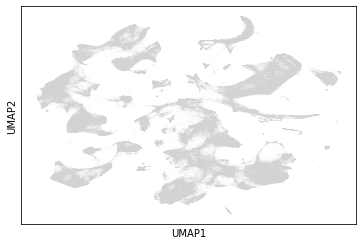

In [27]:
sc.pl.umap(adata)

In [1497]:
plt.rcParams['figure.figsize'] = [15,15]
sc.pl.umap(adata, color=['anno_lvl_1_final','anno_lvl_0_final'], legend_loc="on data")

KeyError: 'Could not find key anno_lvl_1_final in .var_names or .obs.columns.'

<Figure size 2311.2x1080 with 0 Axes>

## Load marker genes

In [1168]:
marker_genes_dir = '../../metadata/marker_genes/'
for file in [x for x in os.listdir(marker_genes_dir) if '2021.csv' in x]:
    with open(marker_genes_dir + file) as f:
        header = f.readline().rstrip()
        if "cluster" in header:
            marker_df = pd.read_csv(marker_genes_dir + file).iloc[:,0:2]
            marker_df.columns = ["anno_lvl_2", "gene"]
            marker_df = marker_df[["gene", "anno_lvl_2"]] 
        else:
            marker_df = pd.read_csv(marker_genes_dir + file, header=None).iloc[:,0:2]
            marker_df.columns = ["gene", "anno_lvl_2"]
    marker_df["anno_lvl_2"] = marker_df["anno_lvl_2"].str.upper()
    marker_df.to_csv(marker_genes_dir + file.strip(".csv") + "_clean.csv")

In [1348]:
filenames = [x for x in os.listdir(marker_genes_dir) if '_clean.csv' in x]
split_names = [x.split("_marker_genes")[0] for x in filenames]

all_markers_ls = []
for i in range(len(filenames)):
    marker_df = pd.read_csv(marker_genes_dir + filenames[i], index_col=0)
    marker_df["split"] = split_names[i]
    all_markers_ls.append(marker_df)

In [1349]:
all_markers_df = pd.concat(all_markers_ls, 0)
all_markers_df["anno_lvl_2"] = [re.split(" CELLS?$", x)[0] for x in all_markers_df["anno_lvl_2"]]
all_markers_df["anno_lvl_2"] = ["_".join(x.split(" ")) for x in all_markers_df["anno_lvl_2"]]
all_markers_df["anno_lvl_2"] = [re.sub("MAC$", "MACROPHAGE", x) for x in all_markers_df["anno_lvl_2"]]

In [1350]:
all_annos = pd.concat(all_markers_ls, 0)["anno_lvl_2"].unique()
all_annos[~pd.Series(all_annos).isin(adata.obs["anno_lvl_2_final"].unique())]

array(['DN(EARLY) T CELL', 'EARLY_ERY', 'DN(EARLY)', 'DN(P)', 'DN(Q)',
       'DP(P)', 'DP(Q)', 'PRO TO PRE B CELL', 'IMMATURE B CELL',
       'ASDC_TDC', 'MZM_MAC', 'MAC', 'MONO', 'MONO_4', 'NK_LYMPH',
       'RP_MAC', 'RP_MAC_(IRON_RECLYING)', 'FIBROBLAST',
       'SPLENIC FIBROBLAST', 'MYOFIBROBLAST', 'MUSCLE SATELLITE CELLS',
       'MESOTHELIUM', 'PERIVASCULAR MACROPHAGE', 'SKELETAL MUSCLE',
       'SMOOTH MUSCLE', 'INTERSTITIAL CELLS OF CAJAL', 'OSTEOBLAST',
       'GLIAL CELL', 'NEURON', 'MELANOCYTE', 'KERATINOCYTE', 'HEPATOCYTE',
       'DEVELOPING NEPHRON', 'EPITHELIUM', 'CYCLING EPITHELIUM',
       'CYCLING FIBROBLAST', 'ENTEROENDOCRINE CELL', 'ENDOTHELIUM',
       'VSMC/PERICYTE', 'MESENCHYMAL LYMPHOID TISSUE ORGANISER',
       'CHONDROCYTE'], dtype=object)

## Match anno_lvl_2 to lvl_1 and lvl_0

How to do this? Anno lvl 1 corresponds to the lower resolution clustering

In [27]:
keep_anno = ["LYMPHOID", 
             "MYELOID", 
             "MEM_PROGENITORS",
             "STROMA"
            ]

In [30]:
lvl_matching_df_all = pd.DataFrame()

for s in keep_anno:
    anno_spl_df = anno_obs[["anno_lvl_1_" + s, "anno_lvl_2_" + s]]
    lvl_matching_df = anno_spl_df.dropna().drop_duplicates().reset_index()[["anno_lvl_1_" + s, "anno_lvl_2_" + s]]
    lvl_matching_df.columns = ["anno_lvl_1", "anno_lvl_2"]
    lvl_matching_df["split"] = s
    lvl_matching_df_all = pd.concat([lvl_matching_df_all, lvl_matching_df], 0)

lvl_matching_df_all = pd.concat([lvl_matching_df_all, pd.DataFrame(dict(zip(lvl_matching_df_all.columns, ["pDC", "pDC", np.nan])), index=[0])], 0)

lvl_matching_df_all["anno_lvl_2_final"] = lvl_matching_df_all["anno_lvl_2"].copy()
anno_vocabulary = pd.merge(anno_obs[["anno_lvl_2_final","anno_lvl_2_final_clean"]].drop_duplicates(), lvl_matching_df_all, how="left")
anno_vocabulary = anno_vocabulary[~anno_vocabulary["anno_lvl_2_final_clean"].duplicated(keep="first")]

anno_labels = anno_obs["anno_lvl_2_final_clean"][anno_obs["anno_lvl_2_final_clean"]!="nan"].unique().tolist()
anno_labels = [x for x in anno_labels if type(x)==str]

lowQ_labels = [x for x in anno_labels if "DOUBLET" in x]
lowQ_labels.extend([x for x in anno_labels if "HIGH_MITO" in x])
lowQ_labels.extend([x for x in anno_labels if "LOW_Q" in x])
lowQ_labels.extend([x for x in anno_labels if "CONTAMINANTS" in x])
lowQ_labels.extend(["ELP"])

progenitors_labels = [x for x in progenitors_anno_df["anno_lvl_2"].unique() if x.endswith("P")]
B_labels = [x for x in anno_vocabulary["anno_lvl_2_final_clean"] if x.endswith("B") or x.endswith("B1")]

anno_vocabulary["anno_lvl_0"] = anno_vocabulary["split"].copy()
anno_vocabulary["anno_lvl_0"] = ["ILC" if "ILC" in anno_vocabulary["anno_lvl_2_final_clean"].iloc[x] else anno_vocabulary["anno_lvl_0"].iloc[x] for x in range(len(anno_vocabulary["anno_lvl_2_final_clean"]))]
anno_vocabulary["anno_lvl_0"] = ["PROGENITORS" if anno_vocabulary["anno_lvl_2_final"].iloc[x] in progenitors_labels else anno_vocabulary["anno_lvl_0"].iloc[x] for x in range(len(anno_vocabulary["anno_lvl_2_final_clean"]))]
anno_vocabulary["anno_lvl_0"] = ["B CELLS" if anno_vocabulary["anno_lvl_2_final_clean"].iloc[x] in B_labels else anno_vocabulary["anno_lvl_0"].iloc[x] for x in range(len(anno_vocabulary["anno_lvl_2_final_clean"]))]
anno_vocabulary["anno_lvl_0"] = ["OTHER" if anno_vocabulary["anno_lvl_2_final_clean"].iloc[x] in lowQ_labels else anno_vocabulary["anno_lvl_0"].iloc[x] for x in range(len(anno_vocabulary["anno_lvl_2_final_clean"]))]
anno_vocabulary.loc[anno_vocabulary["anno_lvl_0"] == "LYMPHOID", "anno_lvl_0"] = "NK/T CELLS"
anno_vocabulary.loc[anno_vocabulary["anno_lvl_0"] == "MEM_PROGENITORS", "anno_lvl_0"] = "ERYTHROID CELLS"

missing = {'pDC':'PDC',"PROMONOCYTE":"MYELOID", "EARLY_MK":"ERYTHROID CELLS", 
 "DN(P)_T":"NK/T CELLS", "DN(early)_T":"NK/T CELLS", "CMP":"PROGENITORS",
          "VSMC":"STROMA", "EC":"STROMA"}

anno_vocabulary.loc[anno_vocabulary["anno_lvl_2_final_clean"].isin(list(missing.keys())), "anno_lvl_0"] = [missing[x] for x in anno_vocabulary.loc[anno_vocabulary["anno_lvl_2_final_clean"].isin(list(missing.keys())), "anno_lvl_2_final_clean"].values]

In [31]:
anno_groups_dict = {}
for s in anno_vocabulary.anno_lvl_0.unique():
    anno_groups_dict[s] = anno_vocabulary[anno_vocabulary["anno_lvl_0"] == s]["anno_lvl_2_final_clean"].unique()

In [32]:
anno_groups_dict

{'MYELOID': array(['DC3', 'DC2', 'DC1', 'PROLIFERATING_MACROPHAGE', 'EO/BASO/MAST',
        'CD14_MONO', 'CD14+_MACROPHAGE', 'OLFML3+_MICROGLIA',
        'PROMONOCYTE_(PROLIFERATING)', 'CD16+_MACROPHAGE', 'NEUTROPHIL',
        'PROMONOCYTE', 'YS_MACROPHAGE', 'BM_CD14_MONO',
        'KUPFFER_RP_MACROPHAGE', 'PROLIFERATING_KUPFFER_RP_MACROPHAGE',
        'YS_ERY_MACROPHAGE', 'SPLENIC_MACROPHAGE', 'OSTEOCLAST'],
       dtype=object),
 'ERYTHROID CELLS': array(['EARLY_ERY', 'EARLY_MK', 'PROMYELOCYTE', 'ERY_MACROPHAGE',
        'MID_ERY', 'LATE_ERY', 'LATE_MK', 'YS_ERY', 'CYCLING_YS_ERY'],
       dtype=object),
 'B CELLS': array(['LARGE_PRE_B', 'PRE_PRO_B', 'PRO_B', 'CYCLING_B', 'SMALL_PRE_B',
        'MATURE_B', 'B1', 'IMMATURE_B', 'LATE_PRO_B', 'PLASMA_B'],
       dtype=object),
 'OTHER': array(['DOUBLET_IMMUNE_FIBROBLAST', 'LOW_Q_INCONSISTENT',
        'DOUBLET_LYMPHOID_MACROPHAGE', 'LOW_QUALITY', 'HIGH_MITO',
        'HIGH_MITO_DC', 'DOUBLETS_FIBRO_ERY',
        'DOUBLET_ENDOTHELIUM_ERY

In [22]:
# df = pd.read_csv("../../metadata/manual_annotation/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID.csv", index_col=0)

In [864]:
# anno_vocabulary = lvl_matching_df_all[~lvl_matching_df_all["anno_lvl_2"].duplicated(keep="first")]

# ## Save for manual annotation
# anno_vocabulary.to_csv("/home/jovyan/mount/gdrive/Pan_fetal/annotations/annotation_terms.csv")

# anno_vocabulary = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/annotations/annotation_terms_20210725.csv", index_col=0)

# anno_terms_dict = dict(zip(anno_vocabulary["anno_lvl_2"], anno_vocabulary["anno_lvl_1"]))
# anno_obs["anno_lvl_1_final"] = [anno_terms_dict[x] if x in anno_terms_dict.keys() else x for x in anno_obs["anno_lvl_2_final"]]

# anno_terms_dict = dict(zip(anno_vocabulary["anno_lvl_2"], anno_vocabulary["anno_lvl_0"]))
# anno_obs["anno_lvl_0_final"] = [anno_terms_dict[x] if x in anno_terms_dict.keys() else x for x in anno_obs["anno_lvl_2_final"]]

## Visualize clusters and markers
in lineage subsets

### NKT cells

In [810]:
spl_adata = _load_split("NKT")

Trying to set attribute `.obs` of view, copying.


In [811]:
nkt_labels_order = [
    'HSC_MPP',
    'MEMP',
    'HSC_CMP',
    'ELP',
    'PROGENITOR',
    'CMP',
    'DN(P)_DN(EARLY)_T',
    'DP(Q)_T',
 'DN(Q)_T',
 'DP(P)_T',
 'CYCLING_T',
 'ABT(ENTRY)',
 'CD4+T',
 'CD8+T',
  'TH17',
 'CD8AA',
 'TREG',
'NK_T',
 'NK',
 'CYCLING_NK',
 'ILC3',
 'ILC2',
 'CYCLING_ILC',
 'HIGH_MITO',
 'UNKNOWN',
 'DOUBLET']
# spl_adata.obs["anno_lvl_2_final_clean"].unique().tolist()

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo__anno_lvl_2_NKT.png


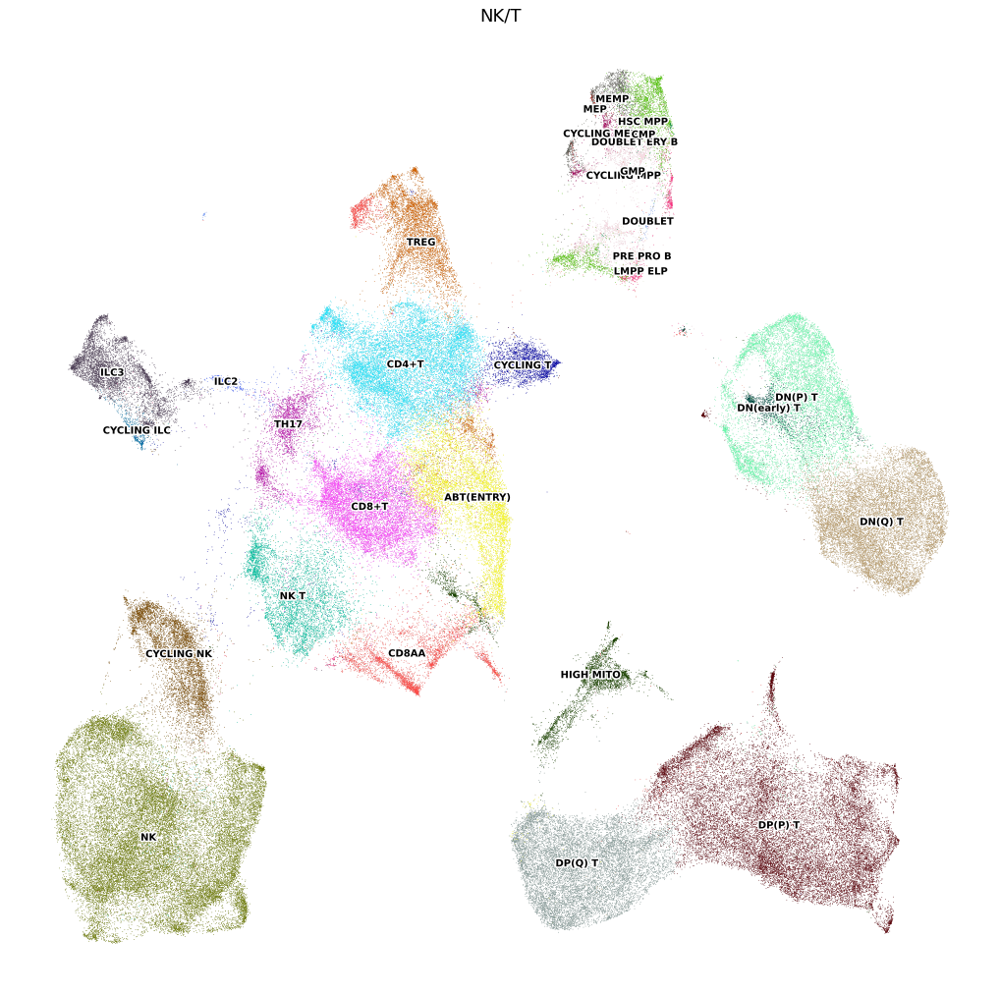

In [815]:
annos = spl_adata.obs["anno_lvl_2_final_clean"].unique()

plt.rcParams['figure.figsize'] = [18,18]
_plot_split_embedding(spl_adata, "NK/T", save="_anno_lvl_2_NKT.png", legend_fontsize=10, 
                      groups=annos[annos!="OTHER"]
                     )

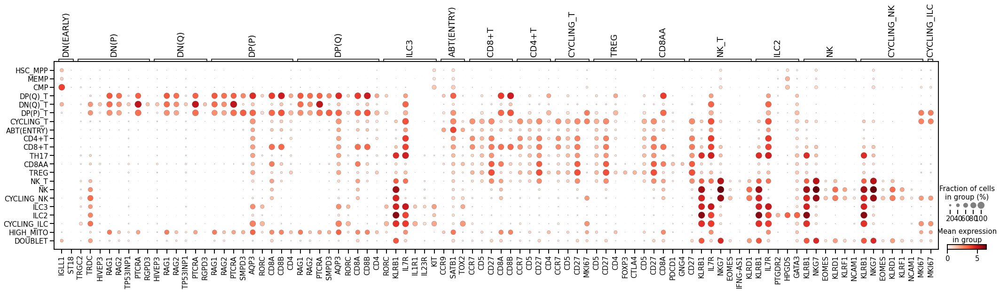

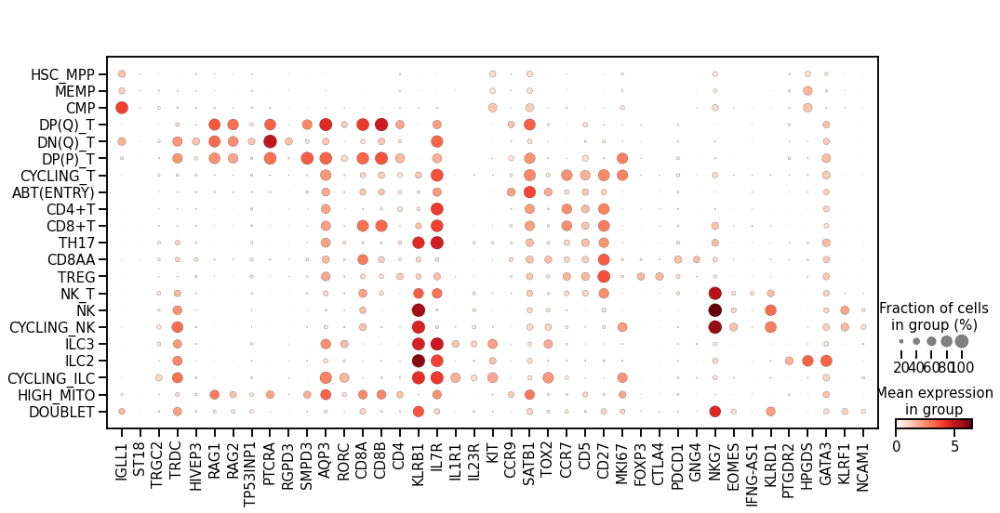

In [816]:
_plot_marker_dotplot(spl_adata, ["NKT"], labels_order=nkt_labels_order, save="_anno_lvl_2_NKT.pdf")
_plot_marker_dotplot(spl_adata, ["NKT"], labels_order=nkt_labels_order, unique_genes=True, save="unique_genes_anno_lvl_2_NKT.pdf")

In [565]:
_save_plot_markers_embedding(spl_adata, ["NKT"])

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_NKT/scvelo_embedding_markers_anno_lvl_2_NKT.DN(EARLY).png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_NKT/scvelo_embedding_markers_anno_lvl_2_NKT.DN(P).png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_NKT/scvelo_embedding_markers_anno_lvl_2_NKT.DN(Q).png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_NKT/scvelo_embedding_markers_anno_lvl_2_NKT.DP(P).png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_NKT/scvelo_embedding_markers_anno_lvl_2_NKT.DP(Q).png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_ma

### Lymphoid cells

In [817]:
spl_adata = _load_split("LYMPHOID")

Trying to set attribute `.obs` of view, copying.


In [818]:
# lymphoid_anno_labels = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_LYMPHOID'].isna()), "anno_lvl_2_final_clean"].dropna().unique().tolist()

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo__anno_lvl_2_LYMPHOID.png


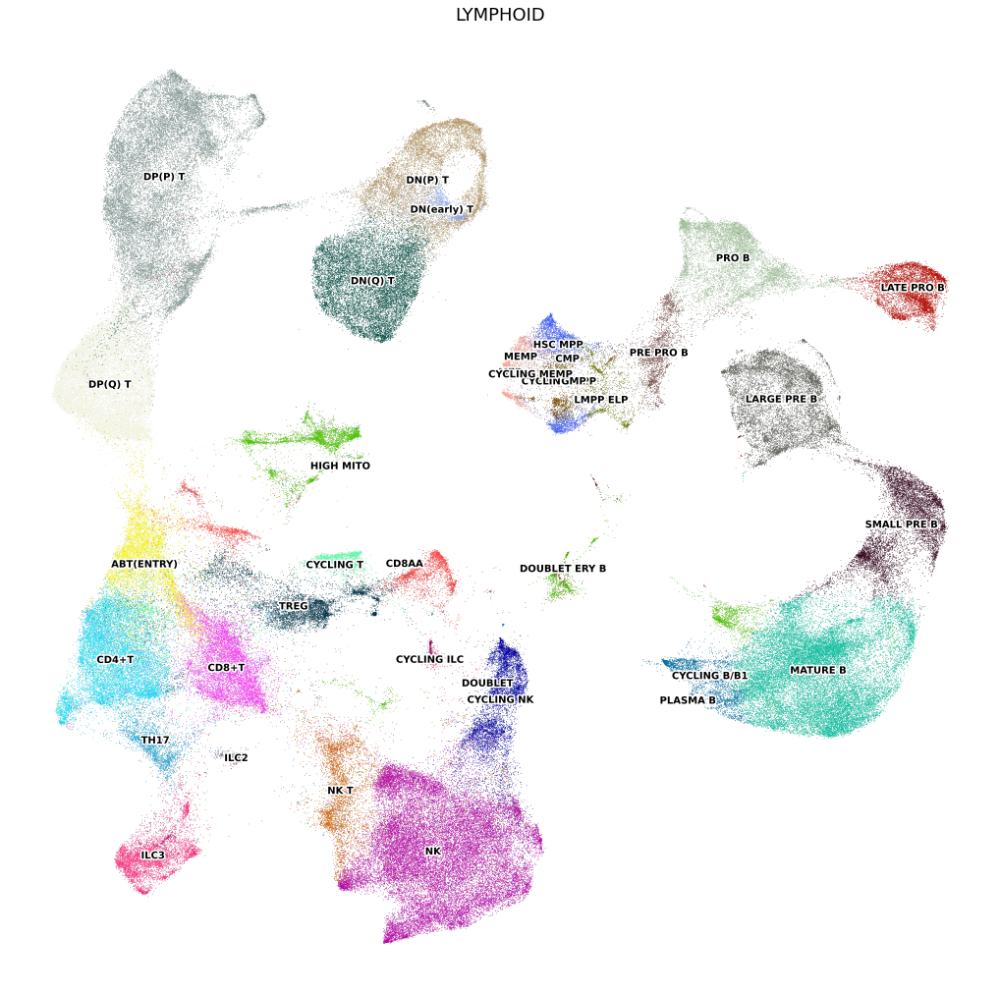

In [819]:
plt.rcParams['figure.figsize'] = [18,18]
annos = spl_adata.obs["anno_lvl_2_final_clean"].unique()
_plot_split_embedding(spl_adata, "LYMPHOID", save="_anno_lvl_2_LYMPHOID.png", legend_fontsize=10, 
                      groups=annos[annos!="OTHER"]
                     )

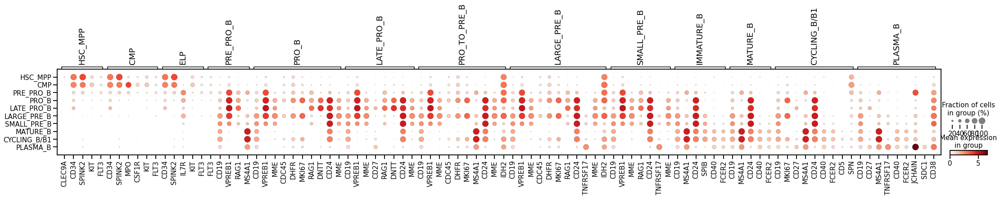

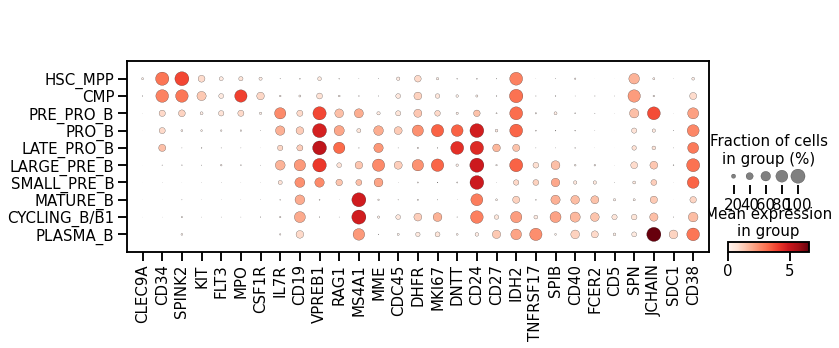

In [820]:
_plot_marker_dotplot(spl_adata, ["B"], save="_anno_lvl_2_B.pdf")
_plot_marker_dotplot(spl_adata, ["B"], unique_genes=True, save="unique_genes_anno_lvl_2_B.pdf")

In [ ]:
_save_plot_markers_embedding(spl_adata, ["B"])

### Myeloid cells

In [ ]:
spl_adata = _load_split("MYELOID")

Trying to set attribute `.obs` of view, copying.


In [822]:
# myeloid_anno_labels = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_MYELOID'].isna()), "anno_lvl_2_final_clean"].dropna().unique().tolist()

In [ ]:
plt.rcParams['figure.figsize'] = [18,18]
annos = spl_adata.obs["anno_lvl_2_final_clean"].unique()
_plot_split_embedding(spl_adata, "scvi_clusters", legend_fontsize=10, 
#                       groups=annos[annos!="OTHER"]
                     )

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo__anno_lvl_2_MYELOID.png


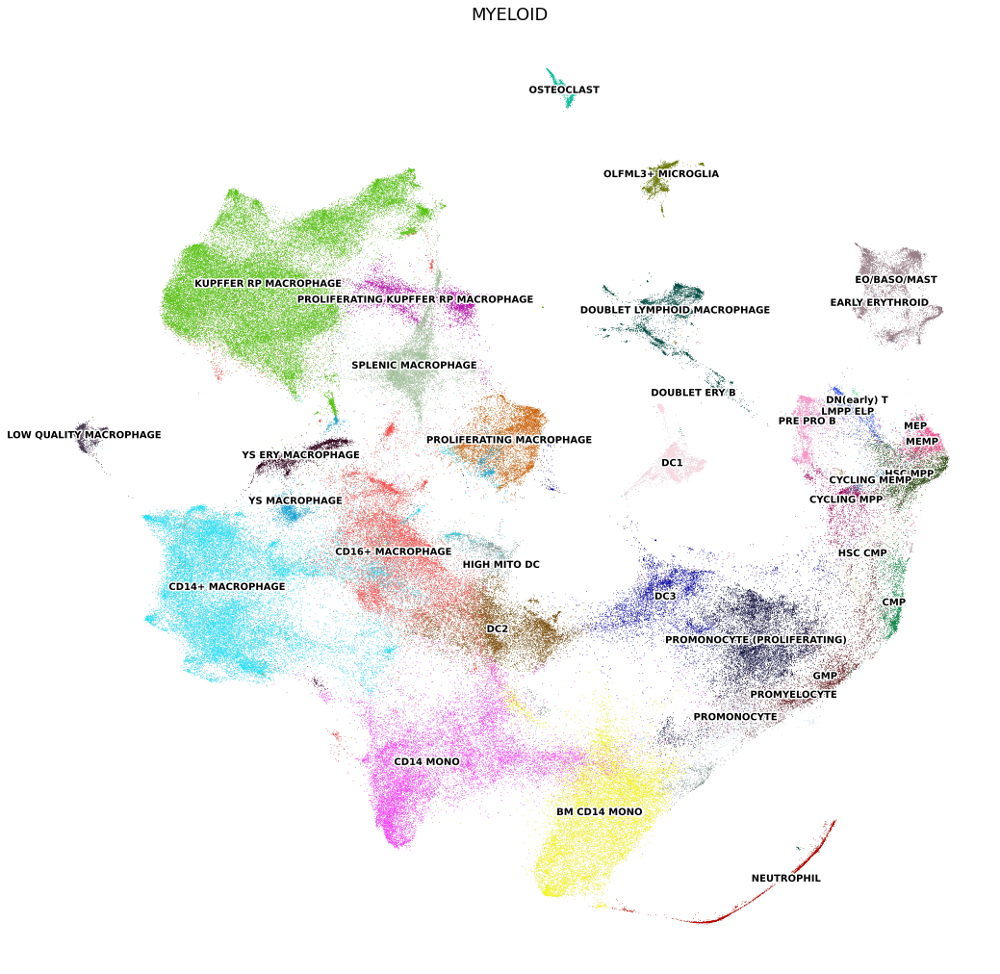

In [823]:
plt.rcParams['figure.figsize'] = [18,18]
annos = spl_adata.obs["anno_lvl_2_final_clean"].unique()
_plot_split_embedding(spl_adata, "MYELOID", save="_anno_lvl_2_MYELOID.png", legend_fontsize=10, 
                      groups=annos[annos!="OTHER"]
                     )

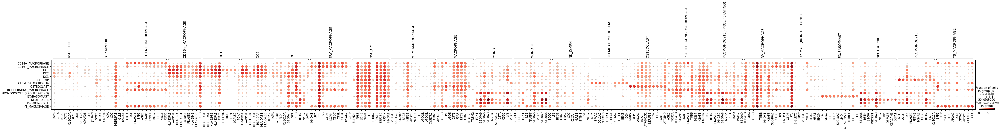

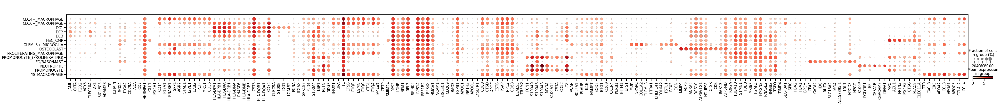

In [824]:
_plot_marker_dotplot(spl_adata, ["MYELOID"], save="_anno_lvl_2_MYELOID.pdf")
_plot_marker_dotplot(spl_adata, ["MYELOID"], unique_genes=True, save="unique_genes_anno_lvl_2_MYELOID.pdf")

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.ASDC_TDC.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.B_LYMPHOID.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.CD14+_MACROPHAGE.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.CD16+_MACROPHAGE.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.DC1.png
saving figure to file /home/jovyan/mount/gdrive/Pan_

FileNotFoundError: [Errno 2] No such file or directory: '/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_MYELOID/scvelo_embedding_markers_anno_lvl_2_MYELOID.EO/BASO/MAST.png'

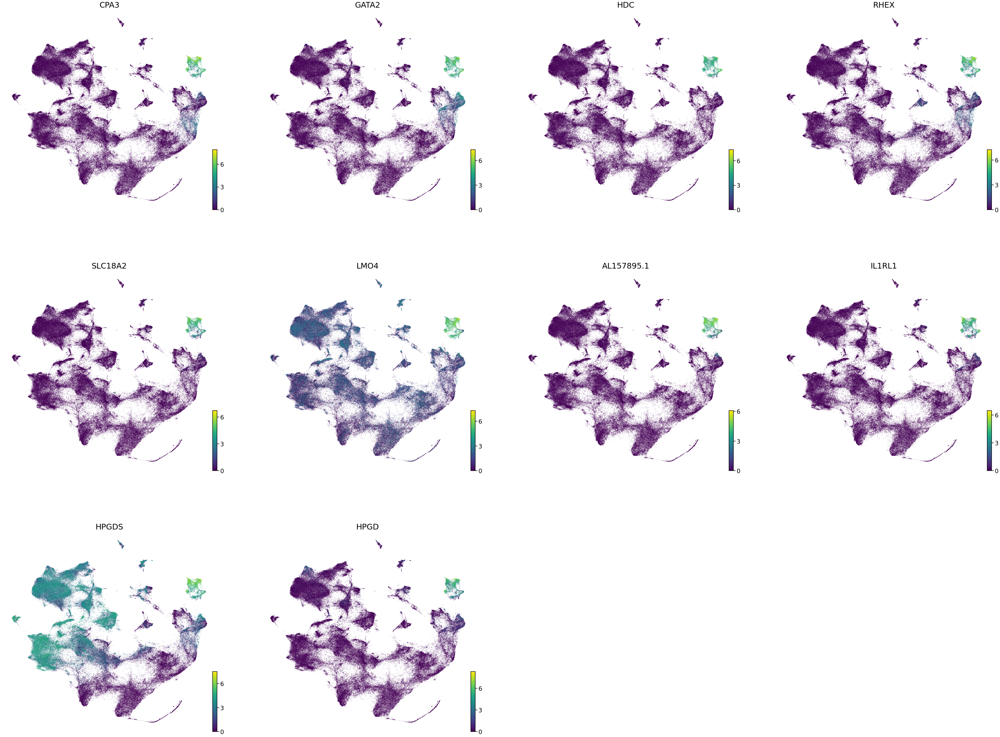

In [571]:
_save_plot_markers_embedding(spl_adata, ["MYELOID"])

### Erythroid cells

In [1498]:
split = "MEM_PROGENITORS"
min_n_cells = 50

spl_adata = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.h5ad'.format(t=timestamp, s=split))
spl_adata = spl_adata[~spl_adata.obs_names.isin(mat_barcodes)]

## Save annotations for split
spl_adata.obs["anno_lvl_2_final_clean"] = anno_obs.loc[spl_adata.obs_names]["anno_lvl_2_final_clean"].astype("str")

## Label as OTHER cell labels that appear in less than 50 cells
small_labels = spl_adata.obs["anno_lvl_2_final_clean"].value_counts()[spl_adata.obs["anno_lvl_2_final_clean"].value_counts() < min_n_cells].index
# spl_adata.obs.loc[spl_adata.obs["anno_lvl_2_final_clean"].isin(small_labels), "anno_lvl_2_final_clean"] = "OTHER"

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [1499]:
# ery_anno_labels = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_MEM_PROGENITORS'].isna()), "anno_lvl_2_final_clean"].dropna().unique().tolist()

In [1500]:
spl_adata.var_names_make_unique()

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo__anno_lvl_2_ERYTHROID.png


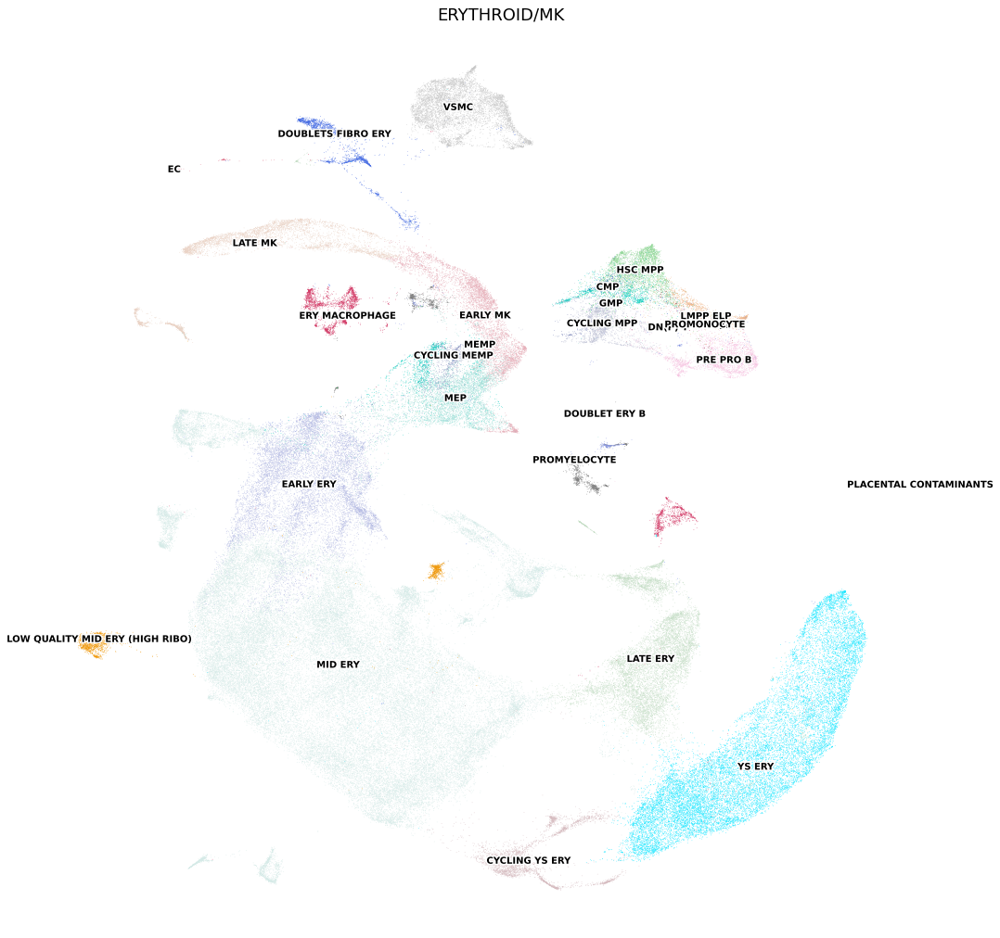

In [1501]:
plt.rcParams['figure.figsize'] = [18,18]
_plot_split_embedding(spl_adata, "ERYTHROID/MK", 
                      save="_anno_lvl_2_ERYTHROID.png", legend_fontsize=10,
#                       groups=ery_anno_labels
                     )

# scv.pl.umap(spl_adata, color=["anno_lvl_2_final_clean", 'leiden_150', 'scvi_clusters'],
#             legend_loc="on data", 
#                 size=2, legend_fontoutline=3,
#                 title=split, legend_fontsize=10,
# #                       groups=ery_anno_labels
#            )

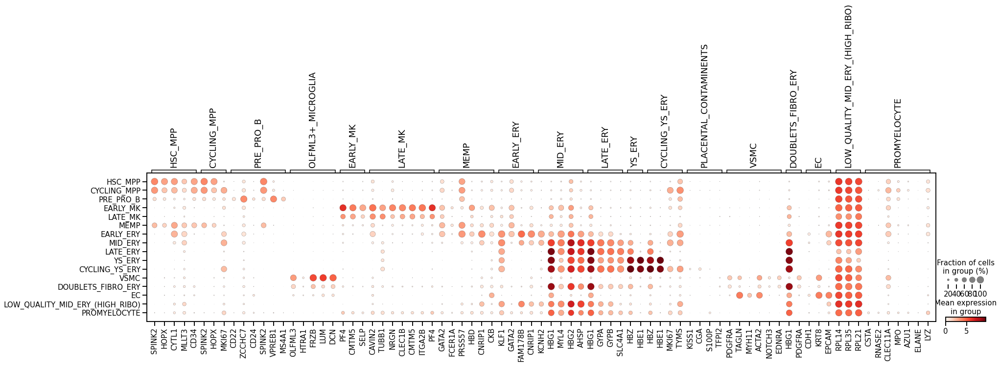

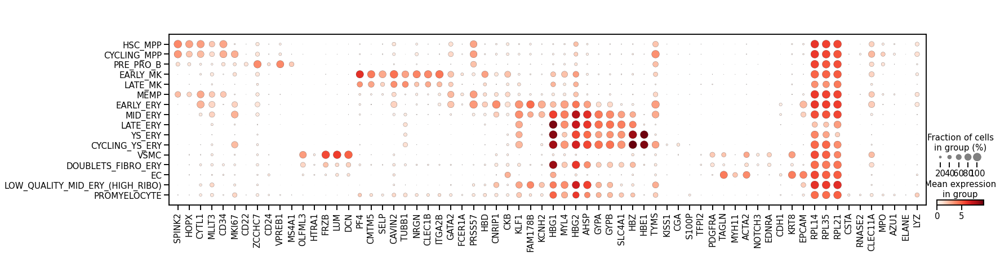

In [1502]:
_plot_marker_dotplot(spl_adata, ["ERYTHROID"], save="_anno_lvl_2_ERYTHROID.pdf")
_plot_marker_dotplot(spl_adata, ["ERYTHROID"], unique_genes=True, save="unique_genes_anno_lvl_2_ERYTHROID.pdf")
# _plot_markers_embedding(spl_adata, ["MYELOID"])

In [575]:
_save_plot_markers_embedding(spl_adata, ["ERYTHROID"])

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_ERYTHROID/scvelo_embedding_markers_anno_lvl_2_ERYTHROID.ERYTHROID_MACROPHAGE.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_ERYTHROID/scvelo_embedding_markers_anno_lvl_2_ERYTHROID.MEMP.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_ERYTHROID/scvelo_embedding_markers_anno_lvl_2_ERYTHROID.MK.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_ERYTHROID/scvelo_embedding_markers_anno_lvl_2_ERYTHROID.PRE_PRO_B.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_ERYTHROID/scvelo_embedding_markers_anno_lvl_2_ERYTHROID.EARLY_ERYTHROID.png
saving figure to file /home/jovyan/

### Stromal cells

In [16]:
spl_adata = _load_split("STROMA", min_n_cells=10)

Trying to set attribute `.obs` of view, copying.


In [17]:
stroma_anno_labels = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_STROMA'].isna()), "anno_lvl_2_final_clean"].dropna().unique().tolist()

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/scvelo__anno_lvl_2_STROMA.png


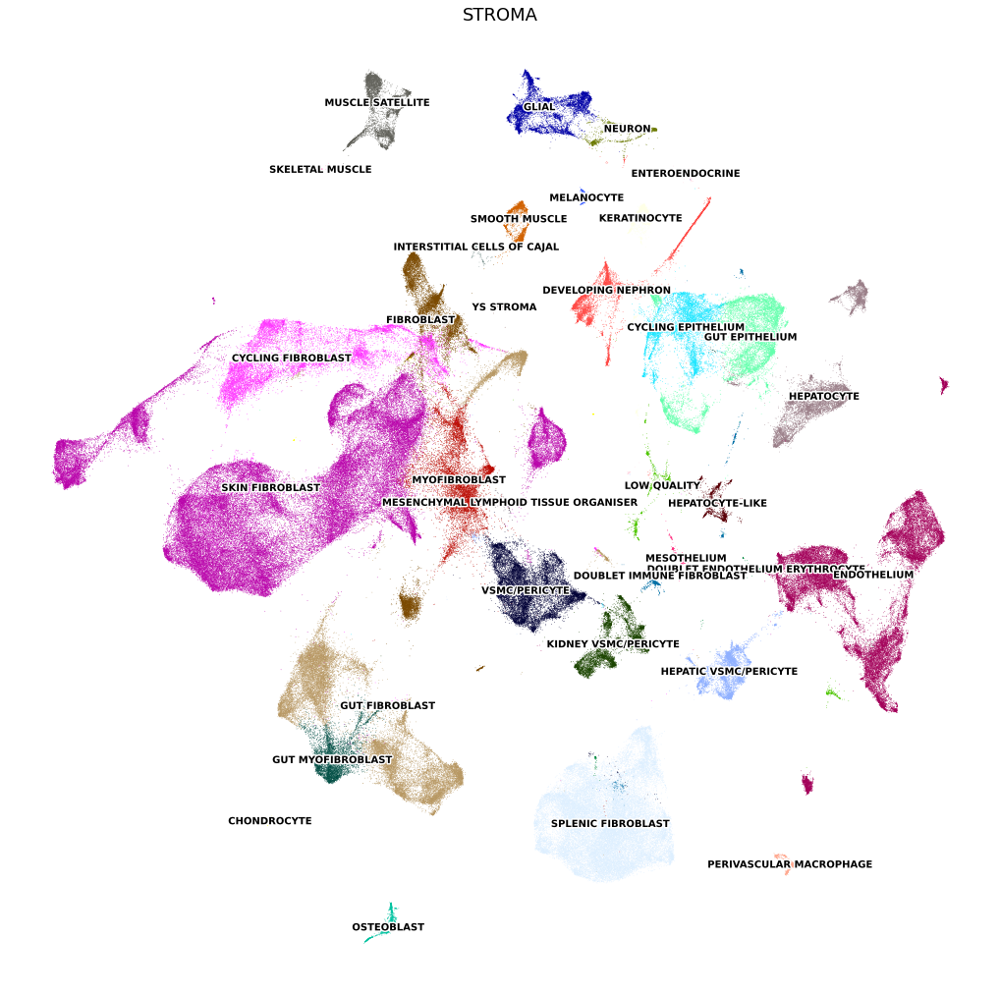

In [23]:
plt.rcParams['figure.figsize'] = [18,18]
_plot_split_embedding(spl_adata, "STROMA", save="_anno_lvl_2_STROMA.png", legend_fontsize=10, 
#                       groups=stroma_anno_labels
                     )

In [24]:
_plot_marker_dotplot(spl_adata, ["STROMA"], save="_anno_lvl_2_STROMA.pdf")
_plot_marker_dotplot(spl_adata, ["STROMA"], unique_genes=True, save="unique_genes_anno_lvl_2_STROMA.pdf")
# _plot_markers_embedding(spl_adata, ["MYELOID"])

NameError: name 'all_markers_df' is not defined

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.FIBROBLAST.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.SPLENIC_FIBROBLAST.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.MYOFIBROBLAST.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.MUSCLE_SATELLITE.png
saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.MESOTHELIUM.png
saving figure to file /home/jovyan/mount/gdrive

FileNotFoundError: [Errno 2] No such file or directory: '/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo_embedding_markers_anno_lvl_2_STROMA.VSMC/PERICYTE.png'

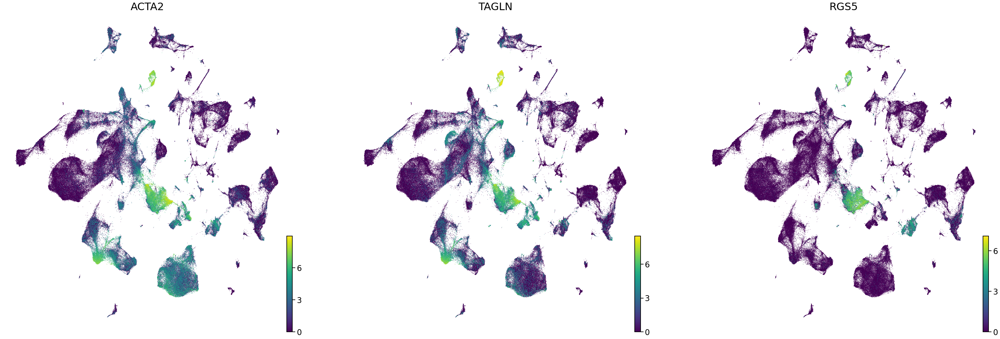

In [578]:
_save_plot_markers_embedding(spl_adata, ["STROMA"])

### Progenitors

In [723]:
spl_adata = _load_split("HSC_PROGENITORS", min_n_cells=10)

Trying to set attribute `.obs` of view, copying.


In [577]:
# stroma_anno_labels = anno_obs.loc[(anno_obs['is_uniquely_annotated'] == 1) & (~anno_obs['anno_lvl_2_STROMA'].isna()), "anno_lvl_2_final_clean"].dropna().unique().tolist()

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/embedding_markers_STROMA/scvelo__anno_lvl_2_HSC_PROGENITORS.png


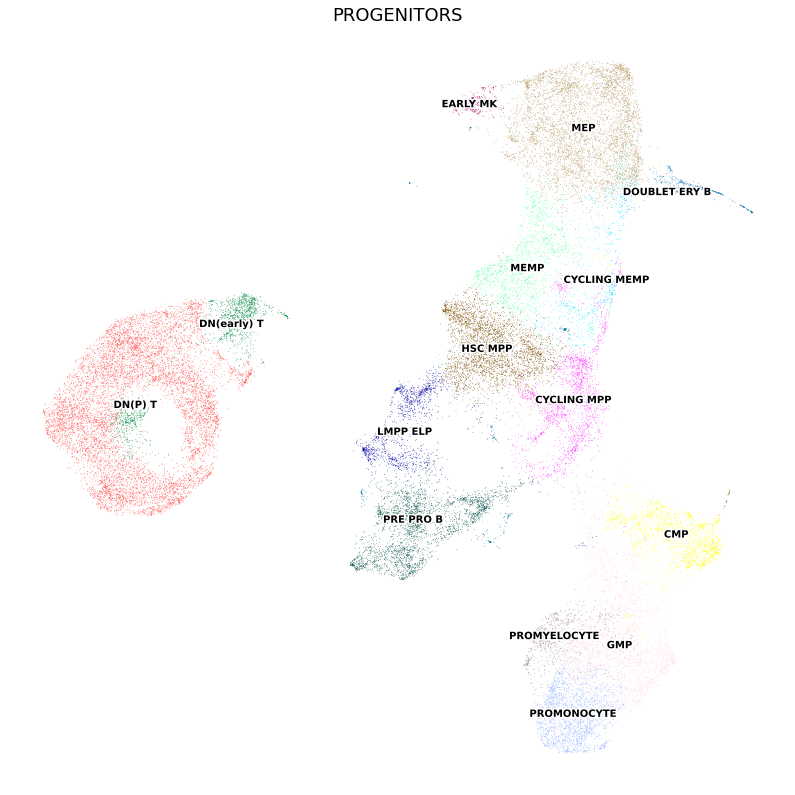

In [725]:
plt.rcParams['figure.figsize'] = [14,14]
_plot_split_embedding(spl_adata, "PROGENITORS", save="_anno_lvl_2_HSC_PROGENITORS.png", legend_fontsize=10)

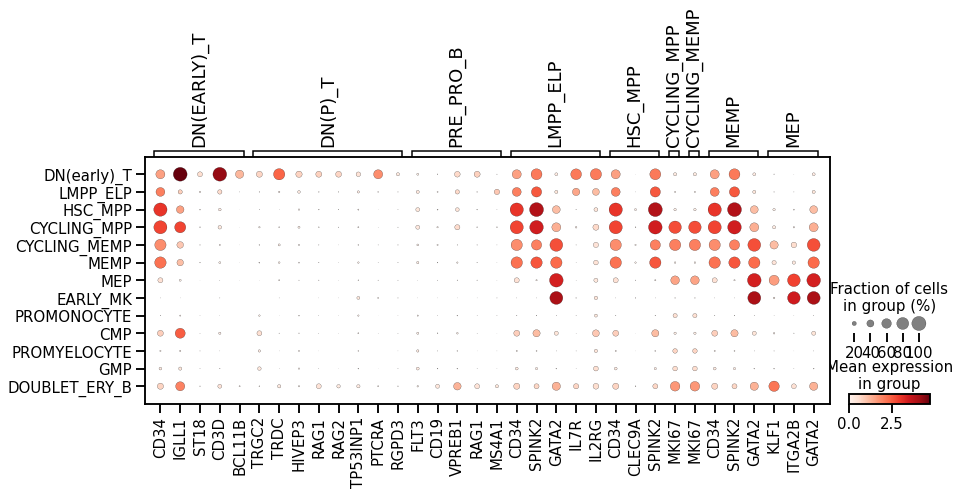

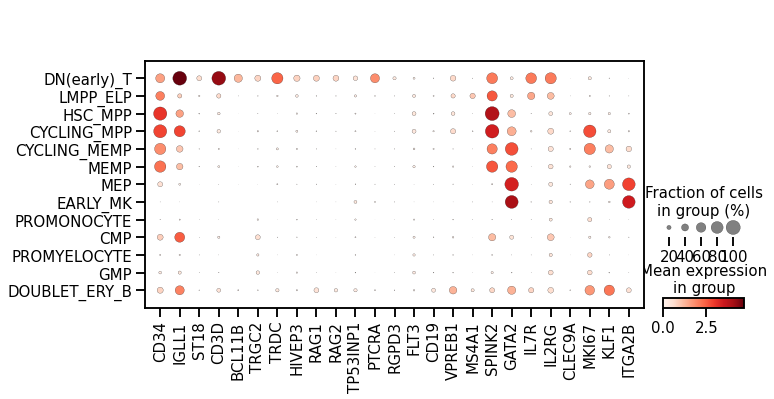

In [751]:
progenitors_labels_order = [
     'DN(early)_T',
     'DN(P)_T'
    'PRE_PRO_B',
    'LMPP_ELP',
    'HSC_MPP',
 'CYCLING_MPP',
    'CYCLING_MEMP',
     'MEMP',
     'MEP',
 'EARLY_MK',
     'PROMONOCYTE',
     'CMP',
 'PROMYELOCYTE',
     'GMP', 
    'DOUBLET_ERY_B'
]

_plot_marker_dotplot(spl_adata, ["HSC_PROGENITORS"], labels_order=progenitors_labels_order, save="_anno_lvl_2_HSC_PROGENITORS.pdf")
_plot_marker_dotplot(spl_adata, ["HSC_PROGENITORS"], labels_order=progenitors_labels_order, unique_genes=True, save="unique_genes_anno_lvl_2_HSC_PROGENITORS.pdf")
# _plot_markers_embedding(spl_adata, ["MYELOID"])

## Compare published VS new annotations

In [45]:
%load_ext rpy2.ipython

In [46]:
%%R
library(tidyverse)
library(ggplot2)

R[write to console]: ── Attaching packages ─────────────────────────────────────── tidyverse 1.3.0 ──

R[write to console]: ✔ ggplot2 3.3.3     ✔ purrr   0.3.4
✔ tibble  3.1.0     ✔ dplyr   1.0.5
✔ tidyr   1.1.3     ✔ stringr 1.4.0
✔ readr   1.4.0     ✔ forcats 0.5.1

R[write to console]: ── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()



In [47]:
reannotated_df = anno_obs[~anno_obs['uniform_label'].isna()]
annotations_conf_mat = sc.metrics.confusion_matrix("uniform_label", "anno_lvl_2_final_clean", reannotated_df, normalize=False)
anno_tot=sc.metrics.confusion_matrix("uniform_label", "anno_lvl_2_final_clean", anno_obs[~anno_obs['uniform_label'].isna()], normalize=False).sum(0)

In [1489]:
## Group labels for plotting
progenitors_labels = [x for x in reannotated_df.anno_lvl_0_final.unique() if x not in anno_vocabulary["anno_lvl_0"].unique() and x != "nan" and "T CELL" not in x]
reannotated_df.loc[reannotated_df.anno_lvl_0_final.isin(progenitors_labels),'anno_lvl_0_final'] = "PROGENITORS"
reannotated_df.loc[reannotated_df.anno_lvl_0_final.isin(['DN(P) T CELL', 'DN(early) T CELL']),'anno_lvl_0_final'] = "NK/T CELLS"

anno_groups_dict = {}
for s in reannotated_df["anno_lvl_0_final"].unique():
    anno_groups_dict[s] = reannotated_df[reannotated_df["anno_lvl_0_final"] == s]["anno_lvl_2_final_clean"].unique()

AttributeError: 'DataFrame' object has no attribute 'anno_lvl_0_final'

In [1093]:
def _plot_old_annotation_confusion(anno_group="B CELLS",
                                   min_cells = 5):
    keep_col = anno_groups_dict[anno_group]
    keep_row = annotations_conf_mat.index[np.any(annotations_conf_mat[anno_groups_dict[anno_group]] > min_cells, 1)]
    conf_mat = annotations_conf_mat.loc[keep_row, keep_col].T
    conf_mat = (conf_mat.T/conf_mat.sum(1)).T

    # row_order = conf_mat.max(1).sort_values(ascending=False).index
    row_order = conf_mat.index.sort_values()
    conf_mat = conf_mat.loc[row_order] ## Sort to have some sort of diagonal

    col_order = conf_mat.mean(0).sort_values(ascending=False).index
    conf_mat = conf_mat[col_order] ## Sort to have some sort of diagonal
    sns.heatmap(conf_mat,xticklabels=True, yticklabels=True)

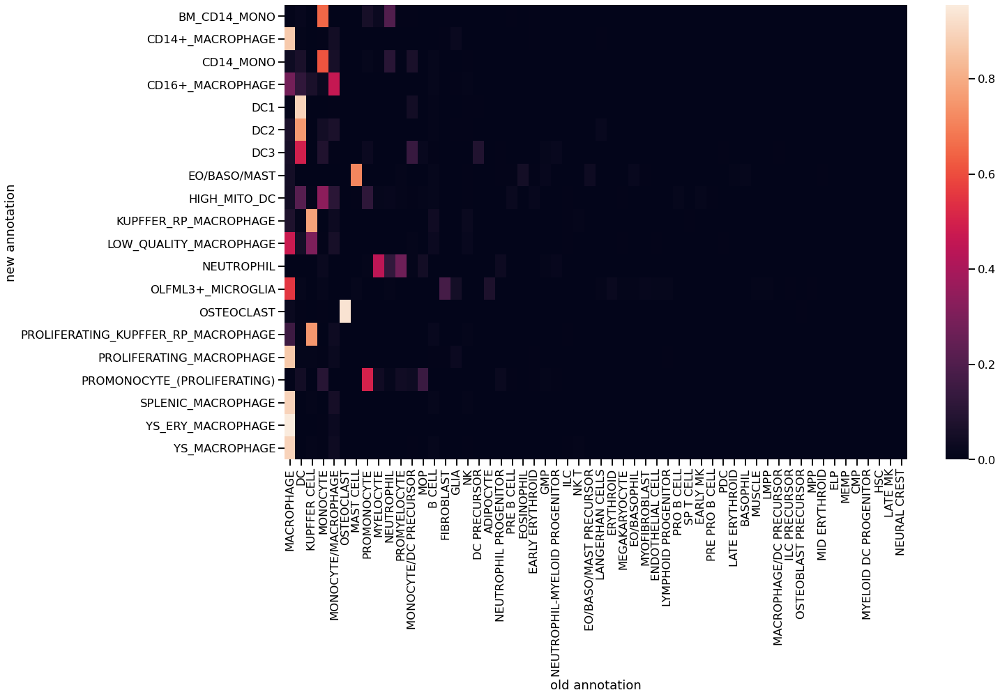

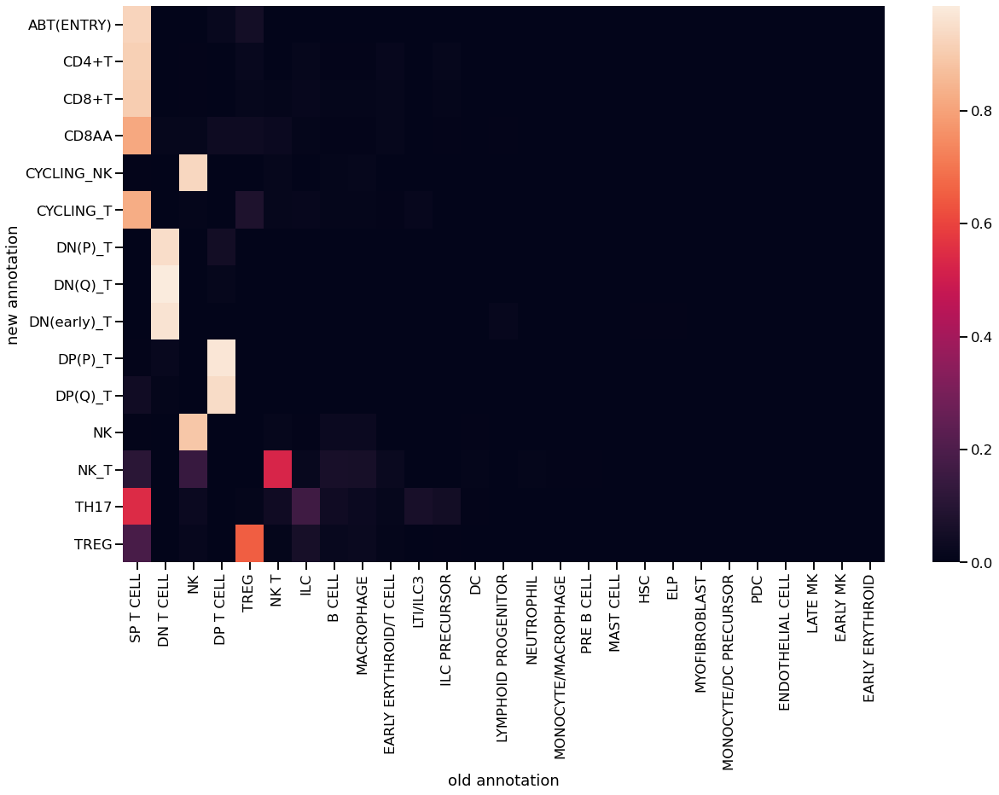

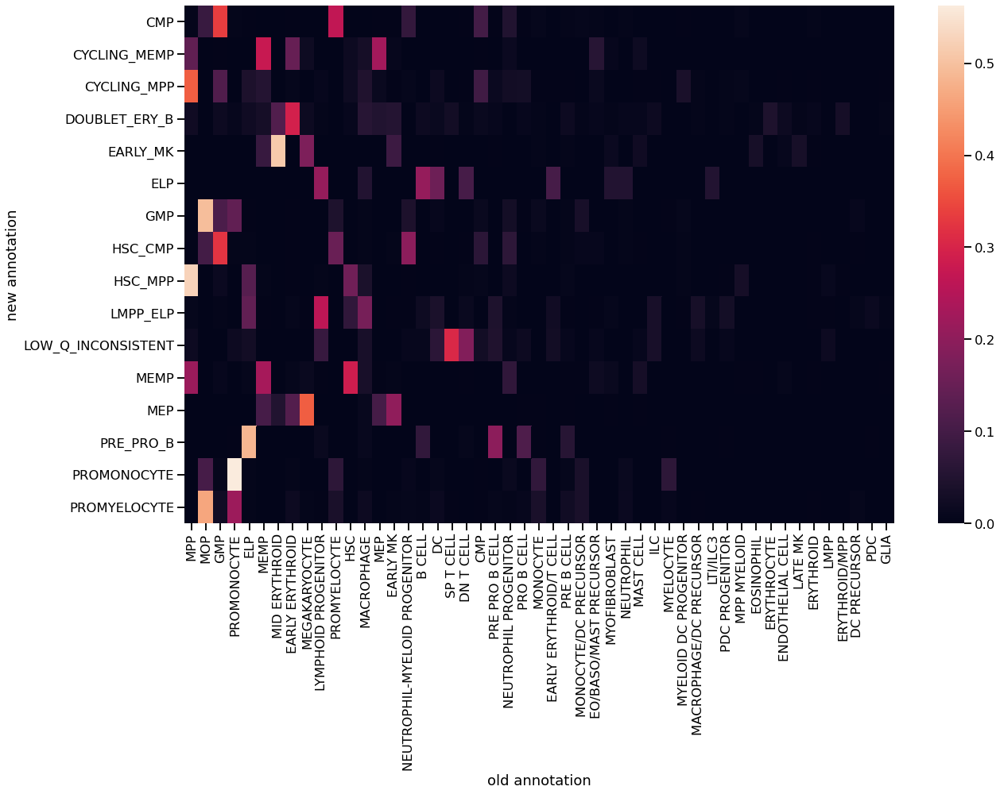

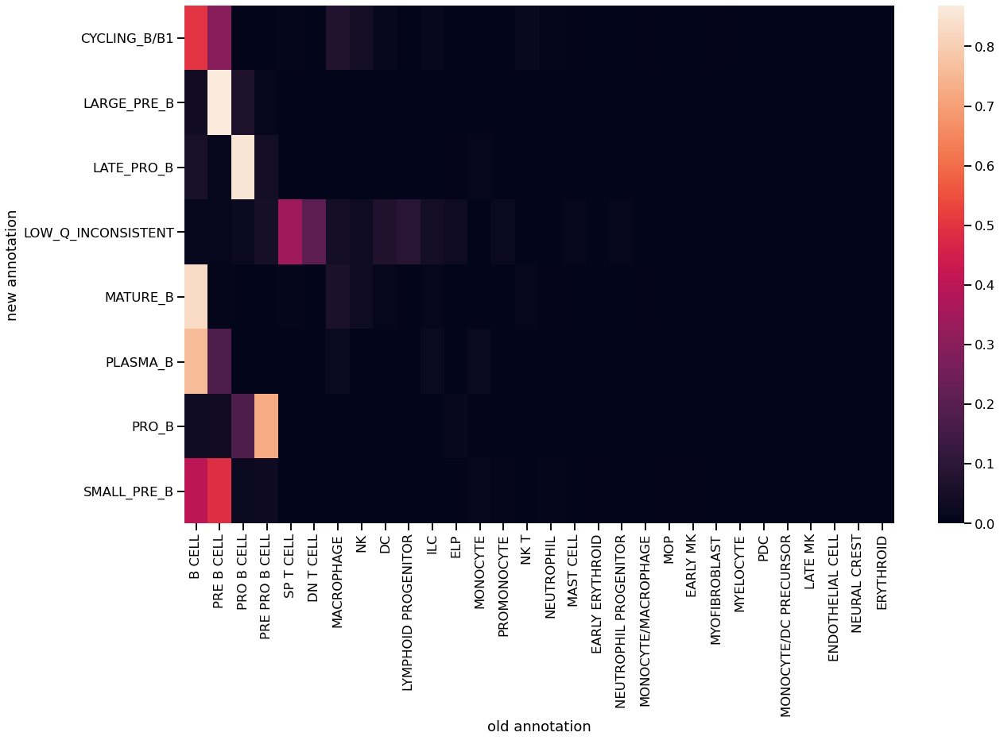

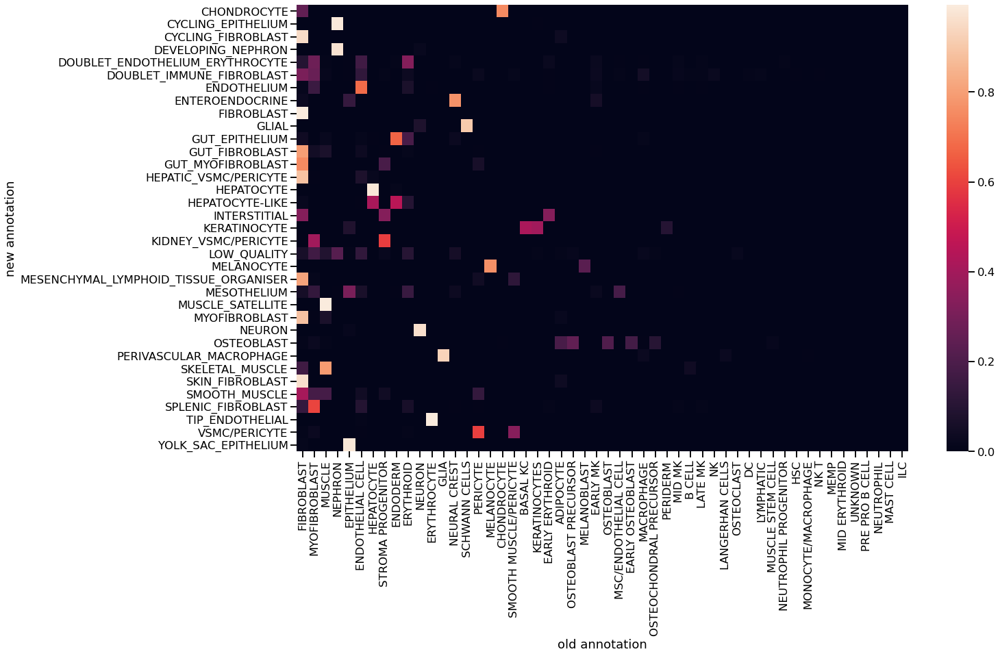

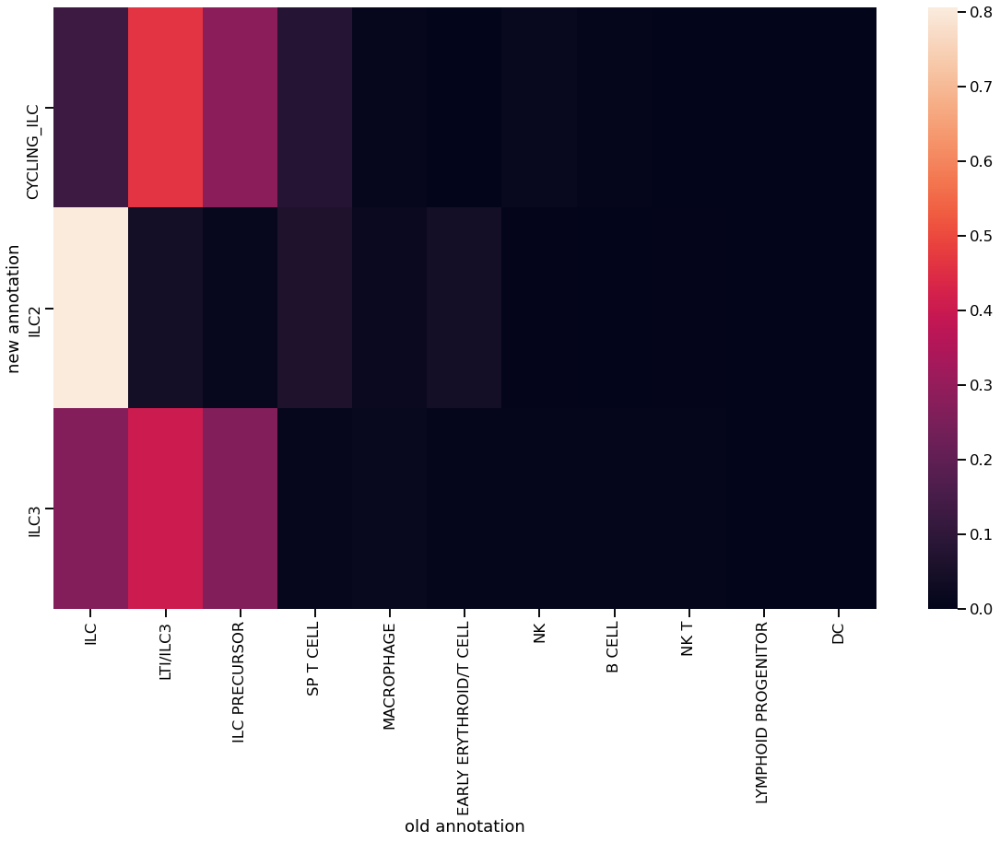

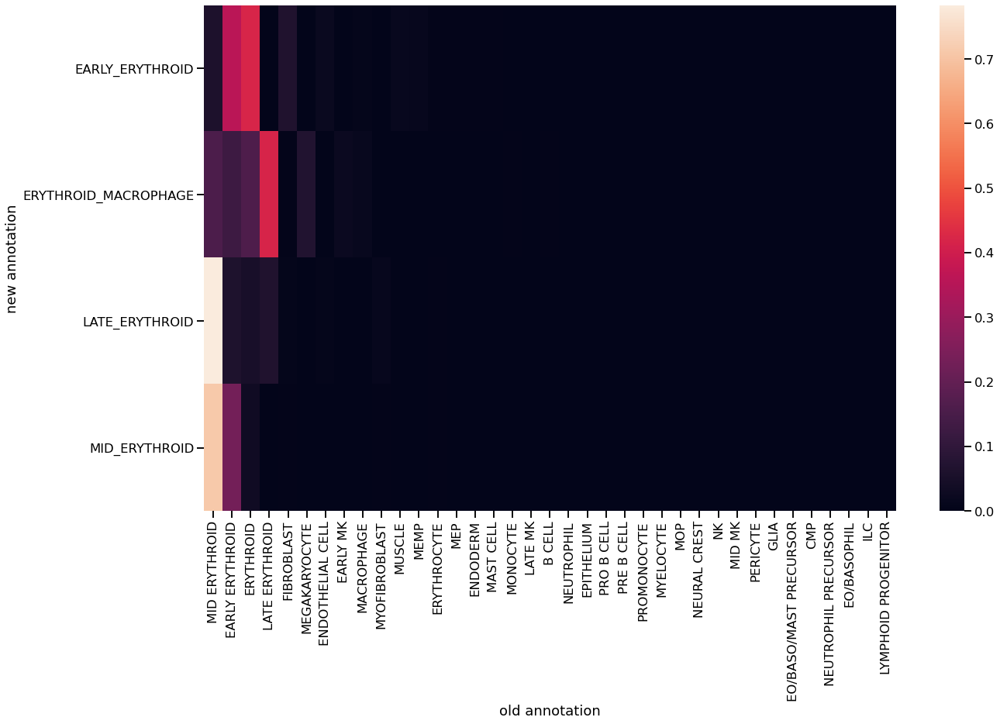

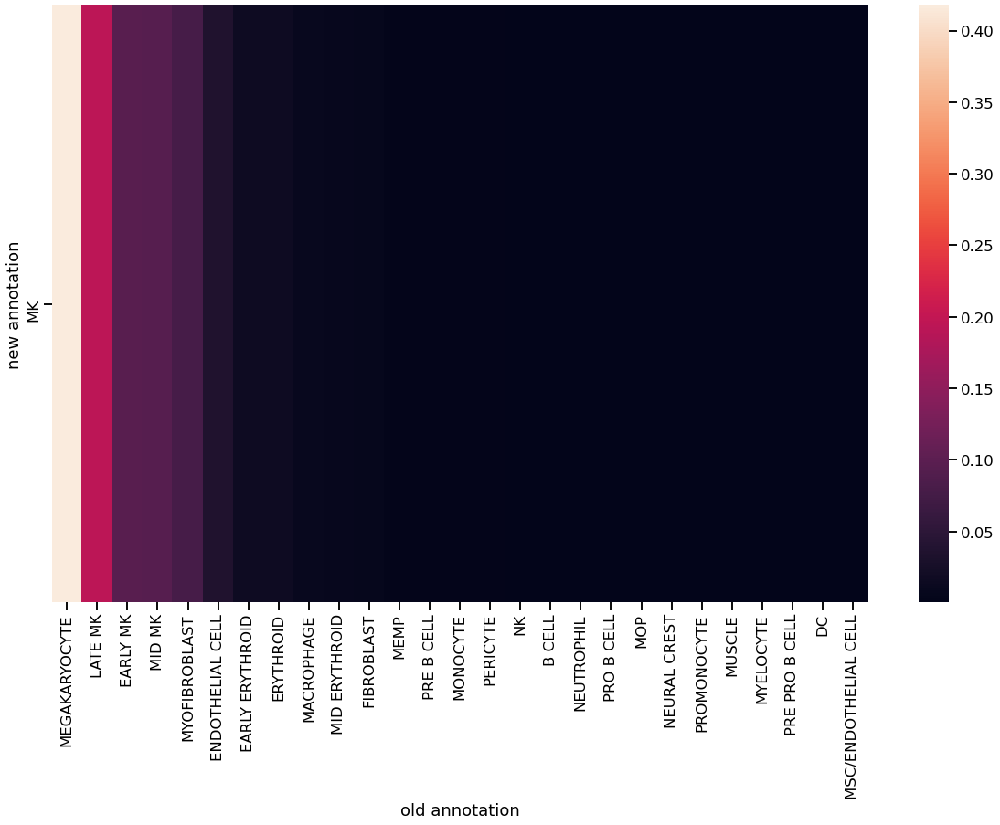

In [1094]:
plt.rcParams["figure.figsize"] = [20,12]
for g in ['MYELOID CELLS', 'NK/T CELLS', 'PROGENITORS', 'B CELLS', 'STROMA', 'ILCS', 'ERYTHROID CELLS', 'MEGAKARYOCYTE CELLS']:
    _plot_old_annotation_confusion(g)
    plt.xlabel("old annotation");
    plt.ylabel("new annotation");
    plt.savefig(figdir + "oldVSnew_{g}.png".format(g="_".join(g.split("/"))), bbox_inches="tight")
    plt.show()

## Organ/age distribution

In [41]:
org_count_df = anno_obs.groupby(["organ", "anno_lvl_2_final_clean"]).count()['is_annotated'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
org_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in org_count_df.anno_lvl_2_final_clean]
org_count_df.loc[org_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
org_count_df["anno"] = org_count_df["anno_lvl_2_final_clean"]

In [42]:
org_colors = pd.read_csv("../../metadata/organ_colors.csv", index_col=0)

In [43]:
age_count_df = anno_obs.groupby(["age", "anno_lvl_2_final_clean"]).count()['is_annotated'].reset_index()
anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}
age_count_df["anno_group"] = [anno_groups_dict_rev[x] if x in anno_groups_dict_rev.keys() else np.nan for x in age_count_df.anno_lvl_2_final_clean]
age_count_df.loc[age_count_df["anno_group"].isna(), "anno_group"] = "ERYTHROID CELLS"
age_count_df["anno"] = age_count_df["anno_lvl_2_final_clean"]

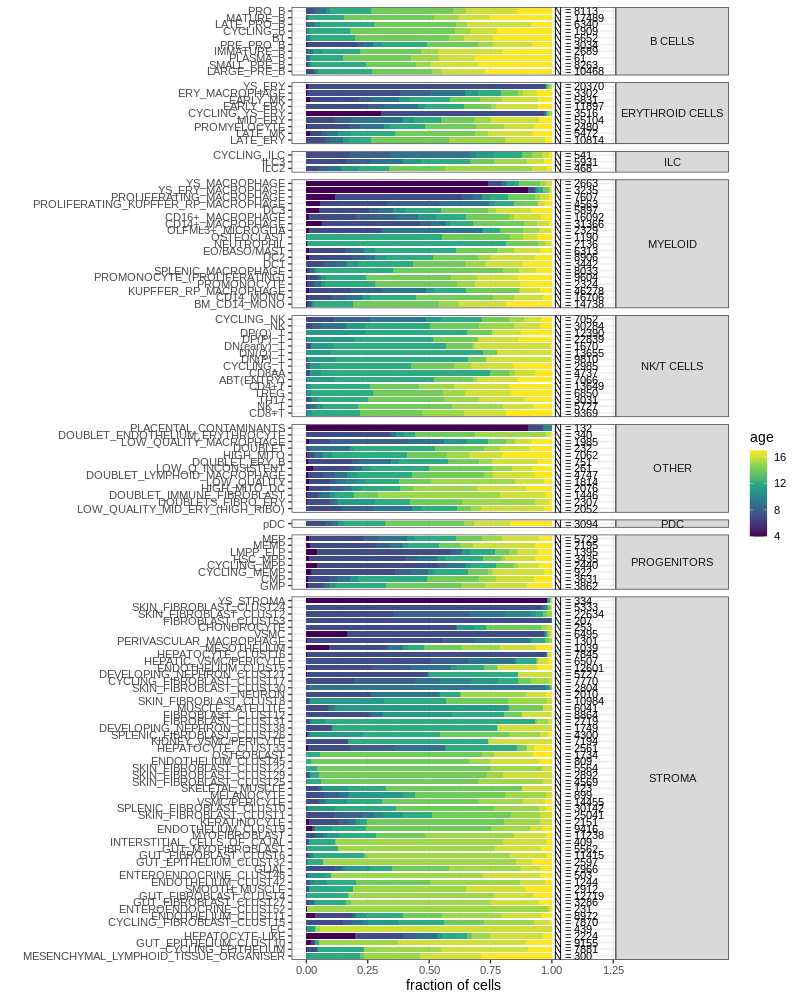

In [49]:
%%R -i age_count_df --i figdir -w 800 -h 1000
age_pl_df <- age_count_df %>%
#     mutate(anno_group= ifelse(anno=="INTERSTITIAL CELLS OF CAJAL", "STROMA", anno_group)) %>%
#     mutate(anno_group= ifelse(anno=="LOW_Q_INCONSISTENT", "OTHER", anno_group)) %>%
    rename(N_cells = is_annotated) %>%
    group_by(anno) %>%
    mutate(max_age = age[which.max(N_cells)])  %>% ## At which age there are most cells?
    mutate(min_age = min(age[which(N_cells > 10)]))  %>%
    ungroup() %>%
    arrange(- max_age) %>%
    mutate(anno=factor(anno, levels=unique(anno))) 
    
age_pl_df %>%
    ggplot(aes(anno, N_cells)) + 
    geom_col(aes(fill=age),position="fill", width=0.8) +
    coord_flip() +
    facet_grid(anno_group~., space="free", scales="free") +
    scale_fill_viridis_c() +
    theme_bw(base_size=14) +
    theme(strip.text.y=element_text(angle=0)) +
    ylab("fraction of cells") + xlab("") +
    expand_limits(y = 1.2) +
    geom_text(data=. %>% group_by(anno) %>% 
              summarise(N_cells=sum(N_cells), anno_group=first(anno_group)),
              hjust=0,
              y=1.01, aes(label=paste("N =", N_cells))
             ) +
    ggsave(paste0(figdir, "age_distribution.pdf"), height=20, width=12) +
    ggsave(paste0(figdir, "age_distribution.png"), height=20, width=12) 

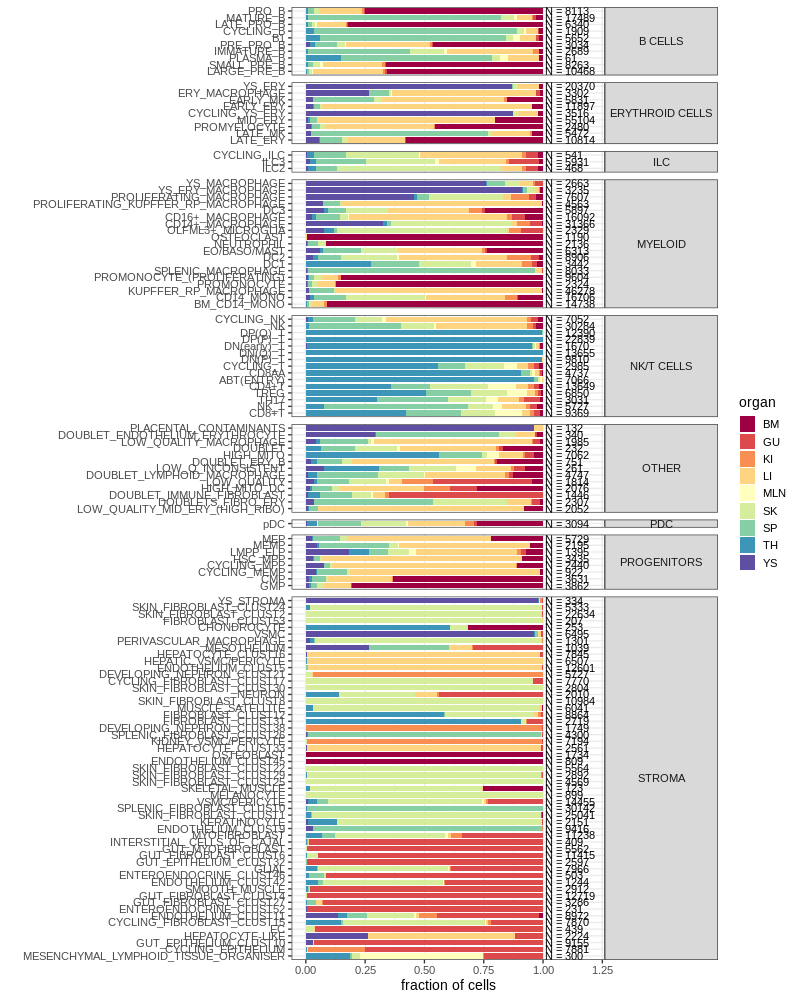

In [51]:
%%R -i org_count_df -i org_colors -i figdir -w 800 -h 1000
org_palette <- setNames(org_colors$color, org_colors$organ)
org_count_df %>%
    mutate(anno_group= ifelse(anno=="INTERSTITIAL CELLS OF CAJAL", "STROMA", anno_group)) %>%
    mutate(anno_group= ifelse(anno=="LOW_Q_INCONSISTENT", "OTHER", anno_group)) %>%
    rename(N_cells = is_annotated) %>%
    mutate(anno=factor(anno, levels=levels(age_pl_df$anno))) %>%
    ggplot(aes(anno, N_cells)) + 
    geom_col(aes(fill=organ) ,position="fill", width=0.8) +
    coord_flip() +
    facet_grid(anno_group~., space="free", scales="free") +
    scale_fill_manual(values=org_palette) +
    theme_bw(base_size=14) +
    theme(strip.text.y=element_text(angle=0)) +
    ylab("fraction of cells") + xlab("") +
    expand_limits(y = 1.2) +
    geom_text(data=. %>% group_by(anno) %>% 
              summarise(N_cells=sum(N_cells), anno_group=first(anno_group)),
              hjust=0,
              y=1.01, aes(label=paste("N =", N_cells))
             ) +
    ggsave(paste0(figdir, "organ_distribution.pdf"), height=20, width=12) +
    ggsave(paste0(figdir, "organ_distribution.png"), height=20, width=12) 

## Save annotations 

In [33]:
anno_obs.to_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.annotated.clean.csv".format(t=timestamp))

In [42]:
data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.annotated.clean.csv".format(t=timestamp)

'/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv'

In [34]:
## Save groupings
import json
with open('../../metadata/anno_groups.json', 'w') as outfile:
    json.dump({k:list(v) for k,v in anno_groups_dict.items()}, outfile)

In [1482]:
adata.obs["predicted_doublets"] = adata.obs["predicted_doublets"].astype("str")

In [1483]:
adata.obs[adata.obs.columns[adata.obs.dtypes=="object"]] = adata.obs[adata.obs.columns[adata.obs.dtypes=="object"]].astype("str")

In [1484]:
adata.write_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.annotated.h5ad'.format(t=timestamp, s="HSC_IMMUNE"))

... storing 'predicted_doublets' as categorical
... storing 'anno_lvl_1_STROMA' as categorical
... storing 'anno_lvl_2_STROMA' as categorical


In [1485]:
data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.annotated.h5ad'.format(t=timestamp, s="HSC_IMMUNE")

'/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.HSC_IMMUNE.embedding.annotated.h5ad'

---

In [7]:
anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.annotated.clean.csv".format(t=timestamp), index_col=0)

# data_dir + "PAN.A01.v01.entire_data_normalised_log.{t}.full_obs.annotated.clean.csv".format(t=timestamp)

In [ ]:
## Load adata with KNN graph for HSC_immune to fix conflicts based on nearest neighbors
adata = sc.read_h5ad(data_dir + 'PAN.A01.v01.entire_data_normalised_log.{t}.{s}.embedding.h5ad'.format(t=timestamp, s="HSC_IMMUNE"))
adata.var_names_make_unique()

anno_obs_hsc_immune = anno_obs.loc[adata.obs_names[adata.obs_names.isin(anno_obs.index)]]

In [ ]:
adata = adata[adata.obs_names.isin(anno_obs.index)]
adata.obs = anno_obs_hsc_immune.copy()

## Pretty plots

In [12]:
## Add metadata and annotations for the reference
anno_obs = pd.read_csv(data_dir + "PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv", index_col=0)

## Read annotation groupings
import json
with open('../../metadata/anno_groups.json', 'r') as json_file:
    anno_groups_dict = json.load(json_file)

anno_groups_dict_rev = {x:g for g,a in anno_groups_dict.items() for x in a}

In [20]:
anno_groups_df = pd.DataFrame([(k,v) for k,v in anno_groups_dict_rev.items()])
anno_groups_df.columns = ["anno_lvl_2", "cell_compartment"]

In [32]:
anno_ct_dict = {
    "DC":["DC1", "DC2", "DC3", "pDC"],
    "MACROPHAGE":['PROLIFERATING_MACROPHAGE',
                 'CD14+_MACROPHAGE',
                 'CD16+_MACROPHAGE',
                 'YS_MACROPHAGE',
                 'KUPFFER_RP_MACROPHAGE',
                 'PROLIFERATING_KUPFFER_RP_MACROPHAGE',
                 'YS_ERY_MACROPHAGE',
                 'SPLENIC_MACROPHAGE',
                 'ERY_MACROPHAGE',
                 'PERIVASCULAR_MACROPHAGE'],
    "MONOCYTE":['CD14_MONO', 'PROMONOCYTE_(PROLIFERATING)', 'PROMONOCYTE', 'BM_CD14_MONO'],
    ""
                
               }

anno_ct_dict_rev = {x:g for g,a in anno_ct_dict.items() for x in a}

In [37]:
toname_anno = anno_groups_df["anno_lvl_2"][~anno_groups_df["anno_lvl_2"].isin(anno_ct_dict_rev.keys())]

In [40]:
[x for x in toname_anno if "MONO" in x]

['CD14_MONO', 'PROMONOCYTE_(PROLIFERATING)', 'PROMONOCYTE', 'BM_CD14_MONO']

---

In [42]:
anno_labels = adata.obs["anno_lvl_2_final_clean"][adata.obs["anno_lvl_2_final_clean"]!="nan"].unique().tolist()
anno_labels = [x for x in anno_labels if type(x)==str]

lowQ_labels = [x for x in anno_labels if "DOUBLET" in x]
lowQ_labels.extend([x for x in anno_labels if "HIGH_MITO" in x])
lowQ_labels.extend([x for x in anno_labels if "LOW_Q" in x])
lowQ_labels.extend([x for x in anno_labels if "CONTAMINANTS" in x])
lowQ_labels.extend(["ELP"])

anno_labels = [x for x in anno_labels if x not in lowQ_labels]

In [59]:
value_to_plot = "anno_lvl_2_final_clean"

In [60]:
scatter_array = adata.obsm["X_umap"]
obs_vals = adata.obs[value_to_plot]
obs_vals.cat.categories = obs_vals.cat.categories.astype(str)

In [64]:
from matplotlib import patheffects

In [76]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
legend_fontweight = "bold" 
legend_fontsize = 10
legend_fontoutline=3
# identify centroids to put labels
texts = []
for label in categories:
    x_pos, y_pos = np.nanmedian(scatter_array[obs_vals == label, :], axis=0)
    if isinstance(label, str):
        label = label.replace("_", " ")
    kwargs = dict(verticalalignment="center", horizontalalignment="center")
    kwargs.update(dict(weight=legend_fontweight, fontsize=legend_fontsize))
    pe = [patheffects.withStroke(linewidth=legend_fontoutline, foreground="w")]
    text = ax.text(x_pos, y_pos, label, path_effects=pe, **kwargs)
    texts.append(text)

saving figure to file /home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/annotations/scvelo__HSC_IMMUNE_umap_noLowQuality.png


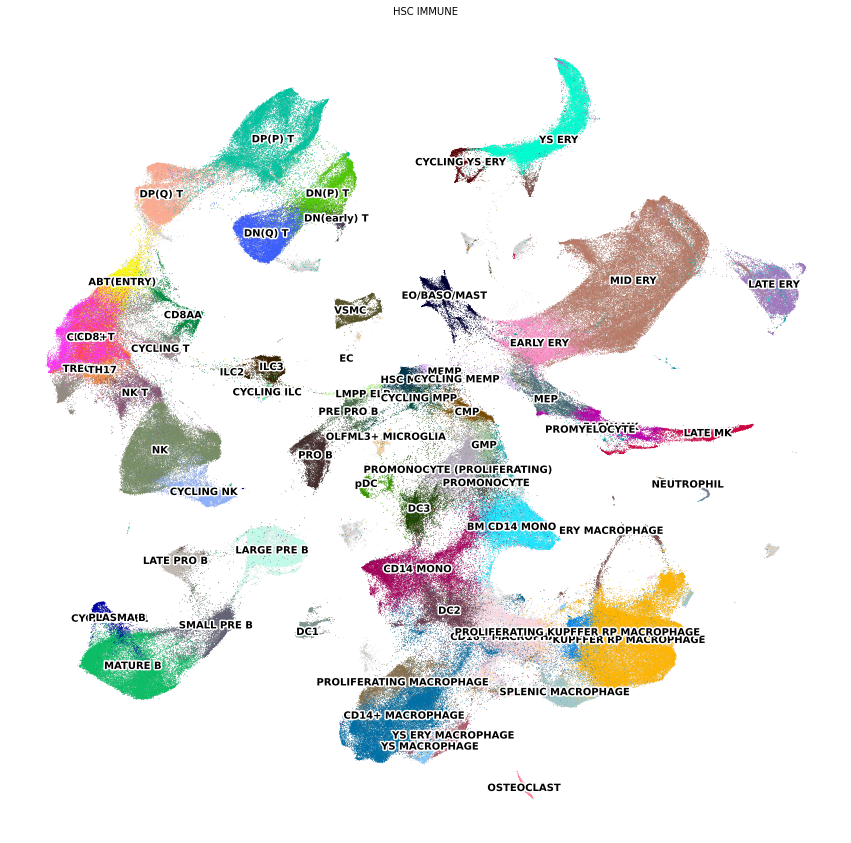

In [52]:
scv.pl.umap(adata, color="anno_lvl_2_final_clean", legend_loc="on data", 
                size=2, legend_fontoutline=3,
                title='HSC_IMMUNE', groups=anno_labels, save="_HSC_IMMUNE_umap_noLowQuality.png")

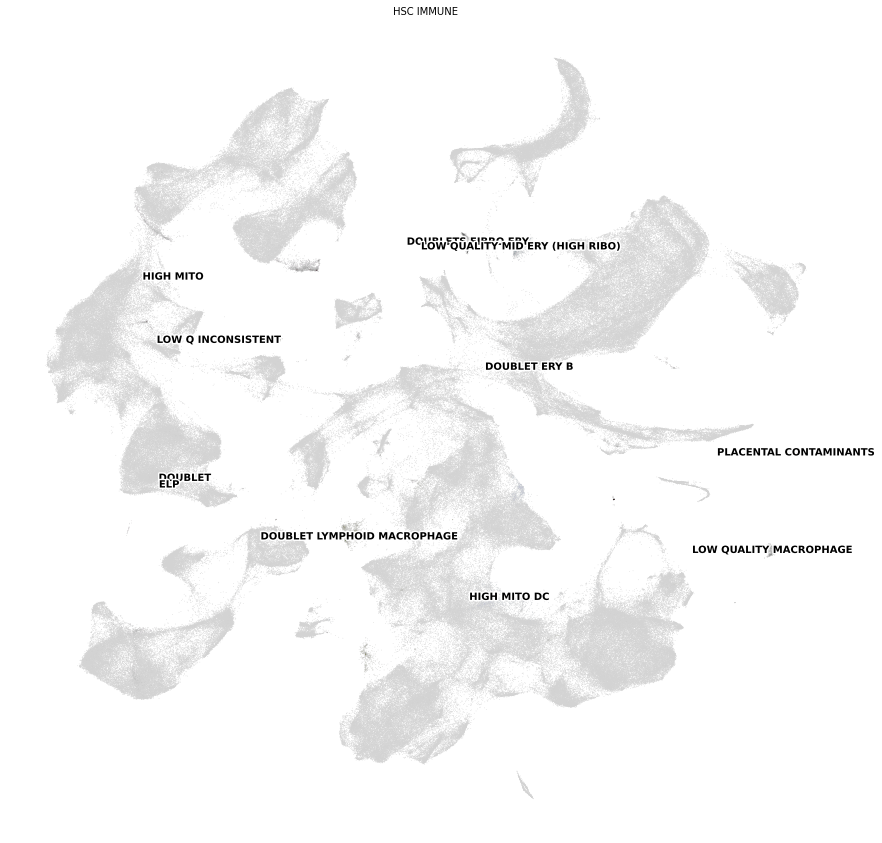

In [55]:
scv.pl.umap(adata, color="anno_lvl_2_final_clean", legend_loc="on data", 
                size=2, legend_fontoutline=3,
                title='HSC_IMMUNE', groups=lowQ_labels)

---

In [46]:
import sctk

<AxesSubplot:title={'center':'anno_lvl_2_final_clean'}, xlabel='UMAP1', ylabel='UMAP2'>

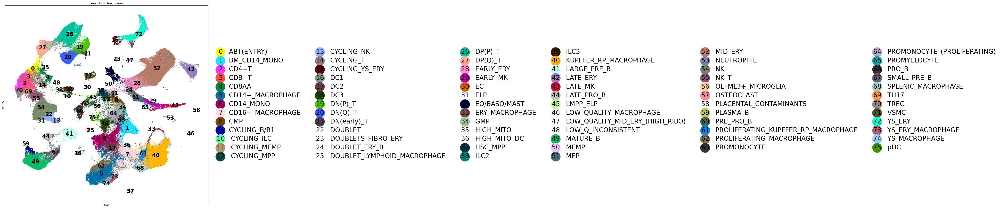

In [49]:
sctk.plot_embedding(adata, groupby="anno_lvl_2_final_clean", figsize=[15,15], size=10, legend_fontsize=24, legend_loc="bottom right", highlight=anno_labels)

In [38]:
color_obs = 'anno_lvl_2_final_clean'
figsize=[15,15]
fontsize=14
version_scale = 1 if sc.__version__.startswith('1.4') else 1

In [39]:
categories = adata.obs[color_obs].cat.categories
categories_no = adata.obs[color_obs].cat.codes

adata.obs["color_obs_no"] = adata.obs[color_obs].cat.codes
adata.obs["color_obs_label"] = "(" + adata.obs["color_obs_no"].astype("str") + ") " + adata.obs[color_obs].astype("str")

NameError: name 'new_texts' is not defined

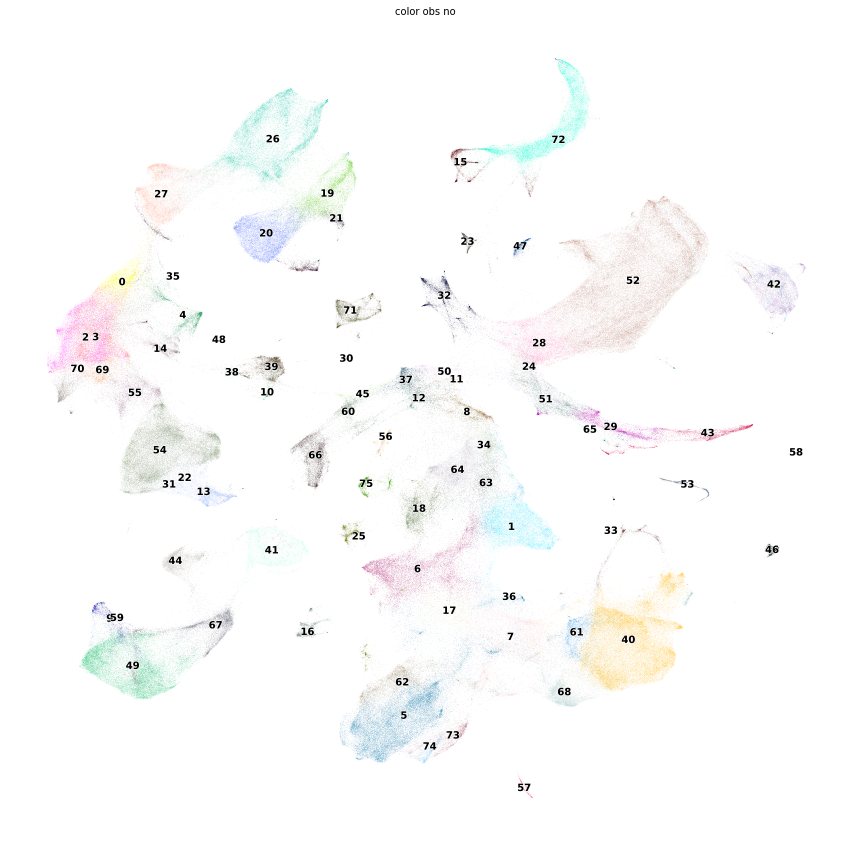

In [40]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
scv.pl.umap(adata, color='color_obs_no', ax=ax, legend_loc='on data', show=False)
anno_df = adata.obs[["color_obs_no", "color_obs_label"]].drop_duplicates()
anno_label_dict = dict(zip(anno_df['color_obs_no'],anno_df['color_obs_label'] ))
# [ax.text(x=t.get_position()[0], y=t.get_position()[1], s=anno_label_dict[t.get_text()], fontsize=fontsize-1.5) for t in ax.texts]
ax.legend(
    labels=new_texts,        
    loc='center left', bbox_to_anchor=(1, 0.5), frameon=False, ncol=int(np.ceil(len(categories)/int(figsize[1]*3)/8*fontsize)),
    fontsize=fontsize*1.1, markerscale=3*(fontsize/11)*version_scale, labelspacing=9/fontsize
        )
fig.show()

In [1271]:
old_texts = [x.get_text() for x in ax.texts]
new_texts = [anno_label_dict[x] for x in old_texts]
# "(" + adata.obs["color_obs_no"].astype("str") + ") " + adata.obs[color_obs].astype("str")

In [1298]:
new_texts

['(0) ABT(ENTRY)',
 '(1) BM_CD14_MONO',
 '(2) CD4+T',
 '(3) CD8+T',
 '(4) CD8AA',
 '(5) CD14+_MACROPHAGE',
 '(6) CD14_MONO',
 '(7) CD16+_MACROPHAGE',
 '(8) CMP',
 '(9) CYCLING_B/B1',
 '(10) CYCLING_ILC',
 '(11) CYCLING_MEMP',
 '(12) CYCLING_MPP',
 '(13) CYCLING_NK',
 '(14) CYCLING_T',
 '(15) CYCLING_YS_ERY',
 '(16) DC1',
 '(17) DC2',
 '(18) DC3',
 '(19) DN(P)_T',
 '(20) DN(Q)_T',
 '(21) DN(early)_T',
 '(22) DOUBLET',
 '(23) DOUBLETS_FIBRO_ERY',
 '(24) DOUBLET_ERY_B',
 '(25) DOUBLET_LYMPHOID_MACROPHAGE',
 '(26) DP(P)_T',
 '(27) DP(Q)_T',
 '(28) EARLY_ERYTHROID',
 '(29) EARLY_MK',
 '(30) EARY_ERY',
 '(31) EC',
 '(32) ELP',
 '(33) EO/BASO/MAST',
 '(34) ERYTHROID_MACROPHAGE',
 '(35) ERY_MACROPHAGE',
 '(36) GMP',
 '(37) HIGH_MITO',
 '(38) HIGH_MITO_DC',
 '(39) HSC_CMP',
 '(40) HSC_MPP',
 '(41) ILC2',
 '(42) ILC3',
 '(43) KUPFFER_RP_MACROPHAGE',
 '(44) LARGE_PRE_B',
 '(45) LATE_ERY',
 '(46) LATE_ERYTHROID',
 '(47) LATE_MK',
 '(48) LATE_PRO_B',
 '(49) LMPP_ELP',
 '(50) LOW_QUALITY_MACROPHAGE'

In [1253]:
from adjustText import adjust_text
adjust_text([anno_label_dict[x] for x in old_texts], ax=ax, text_from_points=False, autoalign=False)

AttributeError: 'str' object has no attribute 'get_position'

<Figure size 1080x1080 with 0 Axes>